# Binary Classification Problems

In [1]:
import openpyxl
import pandas as pd
pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import sklearn
import numpy as np
import statsmodels as sm
import datetime as dt
import math
from pandas.plotting import autocorrelation_plot
#!pip install pmdarima
import pmdarima as pmd

from collections import Counter
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,accuracy_score,roc_curve,classification_report
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
#ensembling
#from mlxtend.classifier import StackingCVClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn import model_selection
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score 
from sklearn.metrics import f1_score, precision_score, recall_score, fbeta_score

import datatable as data_table
from sklearn import tree 
from sklearn import svm 
print("Hello github ")

Hello github 


In [913]:
filepath="dataset.csv"
pd.read_csv(filepath)
#read the whole file
stc = pd.read_csv(filepath)

In [241]:
#To show all culumns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [915]:
len(stc.columns)

56

In [916]:
stc.head()

,ID,Program.Code,From.Grade,To.Grade,Group.State,Is.Non.Annual.,Days,Travel.Type,Departure.Date,Return.Date,Deposit.Date,Special.Pay,Tuition,FRP.Active,FRP.Cancelled,FRP.Take.up.percent.,Early.RPL,Latest.RPL,Cancelled.Pax,Total.Discount.Pax,Initial.System.Date,Poverty.Code,Region,CRM.Segment,School.Type,Parent.Meeting.Flag,MDR.Low.Grade,MDR.High.Grade,Total.School.Enrollment,Income.Level,EZ.Pay.Take.Up.Rate,School.Sponsor,SPR.Product.Type,SPR.New.Existing,FPP,Total.Pax,SPR.Group.Revenue,NumberOfMeetingswithParents,FirstMeeting,LastMeeting,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SchoolGradeTypeLow,SchoolGradeTypeHigh,SchoolGradeType,DepartureMonth,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,SchoolSizeIndicator,Retained.in.2012.
0,1,HS,4.0,4.0,CA,0,1,A,2011-01-14,2011-01-14,2010-08-30,NaN,424,25,3,0.424,2010-03-29,2010-08-12,3,4,2010-03-26,B,Southern California,4.0,PUBLIC,1,K,5.0,927.0,Q,0.170,1,CA History,EXISTING,59,63,424,1,2010-08-12,2010-08-12,155.0,155.0,Elementary,Elementary,Elementary->Elementary,January,K,Elementary,K->Elementary,H,1,0.063646,0.936508,4,L,1
1,2,HC,8.0,8.0,AZ,0,7,A,2011-01-14,2011-01-21,2009-11-15,CP,2350,9,9,0.409,2009-10-20,2010-08-10,11,3,2009-10-02,C,Other,10.0,PUBLIC,1,7,8.0,850.0,A,0.091,0,East Coast,EXISTING,22,25,2350,2,2009-11-17,2010-08-27,423.0,140.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,1,0.025882,0.880000,3,L,1
2,3,HD,8.0,8.0,FL,0,3,A,2011-01-15,2011-01-17,2010-10-15,NaN,1181,17,6,0.708,2010-04-29,2010-08-16,6,3,2010-01-28,C,Other,10.0,PUBLIC,1,6,8.0,955.0,O,0.042,0,East Coast,EXISTING,24,27,1181,1,2010-09-13,2010-09-13,124.0,124.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,1,0.025131,0.888889,3,L,1
3,4,HN,9.0,12.0,VA,1,3,B,2011-01-15,2011-01-17,2011-01-07,NaN,376,0,0,0.000,NaN,NaN,1,0,2010-10-19,NaN,Other,7.0,CHD,0,NaN,NaN,NaN,NaN,0.000,0,East Coast,EXISTING,18,18,376,0,NaN,NaN,NaN,NaN,High,High,High->High,January,Undefined,Undefined,Undefined->Undefined,H,0,NaN,1.000000,0,NaN,0
4,5,HD,6.0,8.0,FL,0,6,T,2011-01-16,2011-01-21,2010-09-30,NaN,865,40,8,0.494,2010-03-29,2010-08-12,9,8,2010-03-23,D,Other,10.0,PUBLIC,1,6,8.0,720.0,C,0.383,0,East Coast,EXISTING,81,89,865,1,2010-08-24,2010-08-24,145.0,145.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,0,0.112500,0.910112,8,M-L,0


In [6]:
stc.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
ID,2389.0,1195.000000,689.789219,1.000000,598.000000,1195.000000,1792.000000,2389.000000
From.Grade,2262.0,7.268347,1.388350,3.000000,7.000000,8.000000,8.000000,12.000000
To.Grade,2239.0,7.912908,1.558226,3.000000,8.000000,8.000000,8.000000,12.000000
Is.Non.Annual.,2389.0,0.154039,0.361062,0.000000,0.000000,0.000000,0.000000,1.000000
Days,2389.0,4.575136,1.432128,1.000000,4.000000,5.000000,5.000000,12.000000
Tuition,2389.0,1615.217664,645.096047,79.000000,1174.000000,1700.000000,2048.000000,4200.000000
FRP.Active,2389.0,16.867727,16.942782,0.000000,6.000000,12.000000,23.000000,257.000000
FRP.Cancelled,2389.0,3.305567,3.677022,0.000000,1.000000,2.000000,4.000000,45.000000
FRP.Take.up.percent.,2389.0,0.570743,0.230666,0.000000,0.455000,0.600000,0.727000,1.000000
Cancelled.Pax,2389.0,4.807451,4.661194,0.000000,2.000000,4.000000,6.000000,39.000000


In [7]:
# a quick describe method shows that in average trips last for 4.5 days. Min day is 1 Max is 12. and an average tuition of 645$ 

In [8]:
stc.describe()

,ID,From.Grade,To.Grade,Is.Non.Annual.,Days,Tuition,FRP.Active,FRP.Cancelled,FRP.Take.up.percent.,Cancelled.Pax,Total.Discount.Pax,CRM.Segment,Parent.Meeting.Flag,MDR.High.Grade,Total.School.Enrollment,EZ.Pay.Take.Up.Rate,School.Sponsor,FPP,Total.Pax,SPR.Group.Revenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SingleGradeTripFlag,FPP.to.School.enrollment,FPP.to.PAX,Num.of.Non_FPP.PAX,Retained.in.2012.
count,2389.000000,2262.000000,2239.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2385.000000,2389.000000,2321.000000,2298.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2389.000000,2052.000000,2052.000000,2389.000000,2298.000000,2389.000000,2389.000000,2389.000000
mean,1195.000000,7.268347,7.912908,0.154039,4.575136,1615.217664,16.867727,3.305567,0.570743,4.807451,2.953537,6.920335,0.858937,8.392072,648.358573,0.207943,0.105902,31.297195,34.250733,1615.217664,1.102135,262.083821,228.978070,0.556718,0.066184,0.900667,2.953537,0.607367
std,689.789219,1.388350,1.558226,0.361062,1.432128,645.096047,16.942782,3.677022,0.230666,4.661194,2.876422,2.745410,0.348160,1.746328,411.727720,0.155654,0.307777,29.131503,31.590096,645.096047,0.611544,79.520208,53.636014,0.496877,0.081112,0.049119,2.876422,0.488439
min,1.000000,3.000000,3.000000,0.000000,1.000000,79.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,19.000000,0.000000,0.000000,2.000000,2.000000,79.000000,0.000000,-204.000000,-204.000000,0.000000,0.000922,0.600000,0.000000,0.000000
25%,598.000000,7.000000,8.000000,0.000000,4.000000,1174.000000,6.000000,1.000000,0.455000,2.000000,1.000000,5.000000,1.000000,8.000000,360.000000,0.100000,0.000000,12.000000,14.000000,1174.000000,1.000000,208.000000,196.750000,0.000000,0.020787,0.882353,1.000000,0.000000
50%,1195.000000,8.000000,8.000000,0.000000,5.000000,1700.000000,12.000000,2.000000,0.600000,4.000000,2.000000,6.000000,1.000000,8.000000,597.000000,0.200000,0.000000,23.000000,26.000000,1700.000000,1.000000,250.000000,233.000000,1.000000,0.045256,0.909091,2.000000,1.000000
75%,1792.000000,8.000000,8.000000,0.000000,5.000000,2048.000000,23.000000,4.000000,0.727000,6.000000,4.000000,10.000000,1.000000,8.000000,825.750000,0.292000,0.000000,41.000000,44.000000,2048.000000,1.000000,287.000000,261.000000,1.000000,0.087517,0.933333,4.000000,1.000000
max,2389.000000,12.000000,12.000000,1.000000,12.000000,4200.000000,257.000000,45.000000,1.000000,39.000000,47.000000,11.000000,1.000000,12.000000,3990.000000,1.750000,1.000000,286.000000,313.000000,4200.000000,2.000000,749.000000,749.000000,1.000000,2.052632,1.000000,47.000000,1.000000


In [9]:
stc.nunique()

ID                                2389
Program.Code                        28
From.Grade                          10
To.Grade                            10
Group.State                         54
Is.Non.Annual.                       2
Days                                12
Travel.Type                          4
Departure.Date                     144
Return.Date                        143
Deposit.Date                       135
Special.Pay                          3
Tuition                           1230
FRP.Active                          93
FRP.Cancelled                       29
FRP.Take.up.percent.               476
Early.RPL                          141
Latest.RPL                         215
Cancelled.Pax                       34
Total.Discount.Pax                  26
Initial.System.Date                296
Poverty.Code                         6
Region                               6
CRM.Segment                         11
School.Type                          4
Parent.Meeting.Flag      

In [10]:
stc.isnull().sum()

ID                                   0
Program.Code                         0
From.Grade                         127
To.Grade                           150
Group.State                          0
Is.Non.Annual.                       0
Days                                 0
Travel.Type                          0
Departure.Date                       0
Return.Date                          0
Deposit.Date                         0
Special.Pay                       1919
Tuition                              0
FRP.Active                           0
FRP.Cancelled                        0
FRP.Take.up.percent.                 0
Early.RPL                          673
Latest.RPL                          19
Cancelled.Pax                        0
Total.Discount.Pax                   0
Initial.System.Date                  8
Poverty.Code                       599
Region                               0
CRM.Segment                          4
School.Type                          0
Parent.Meeting.Flag      

In [11]:
stc['Retained.in.2012.'].value_counts()

1    1451
0     938
Name: Retained.in.2012., dtype: int64

In [12]:
# the target value is imbalanced with a high proportion of Retained Customer to those who left in 2012

# Initial Steps

# 1 Remove dots in column names

In [917]:
stc.columns = [col.replace('.', '') for col in stc.columns]

#stc11=stc1.rename({'Program.Code':'Program Code','Group.State':'Group State'},axis=1)
##df.columns = df.columns.str.replace('[#,@,&]', '')

In [918]:
stc['Retainedin2012'].unique()

array([1, 0], dtype=int64)

# 2 Convert Date Columns into Datetime

In [919]:
stc['DepartureDate'] = pd.to_datetime(stc['DepartureDate'])
stc['ReturnDate'] = pd.to_datetime(stc['ReturnDate'])
stc['DepositDate'] = pd.to_datetime(stc['DepositDate'])

stc['FirstMeeting'] = pd.to_datetime(stc['FirstMeeting'])
stc['LastMeeting'] = pd.to_datetime(stc['LastMeeting'])

# 3 Add a new Column Called 'DepositdaysbeforeDeparture' indicating the diffrence between Departure Date and Deposit Date

In [920]:
stc['DepositdaysbeforeDeparture'] = (stc['DepartureDate'] - stc['DepositDate']).dt.days

In [921]:
stc.isnull().sum()

ID                                   0
ProgramCode                          0
FromGrade                          127
ToGrade                            150
GroupState                           0
IsNonAnnual                          0
Days                                 0
TravelType                           0
DepartureDate                        0
ReturnDate                           0
DepositDate                          0
SpecialPay                        1919
Tuition                              0
FRPActive                            0
FRPCancelled                         0
FRPTakeuppercent                     0
EarlyRPL                           673
LatestRPL                           19
CancelledPax                         0
TotalDiscountPax                     0
InitialSystemDate                    8
PovertyCode                        599
Region                               0
CRMSegment                           4
SchoolType                           0
ParentMeetingFlag        

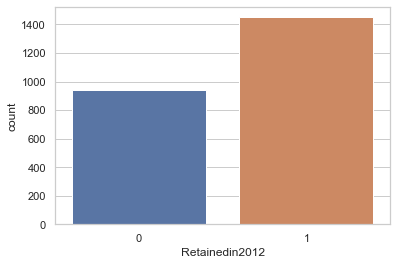

Percentage of non Retained in 2012 is 39.26329007953118
Percentage of Retained in 2012  is    60.73670992046881


In [922]:

sns.countplot(x='Retainedin2012',data=stc)
plt.show()
count_no_sub = len(stc[stc['Retainedin2012']==0])
count_sub = len(stc[stc['Retainedin2012']==1])
pct_of_no_sub = count_no_sub/(count_no_sub+count_sub)
print("Percentage of non Retained in 2012 is", pct_of_no_sub*100)
pct_of_sub = count_sub/(count_no_sub+count_sub)
print("Percentage of Retained in 2012  is   ", pct_of_sub*100)

# Exploratory Data Analysis

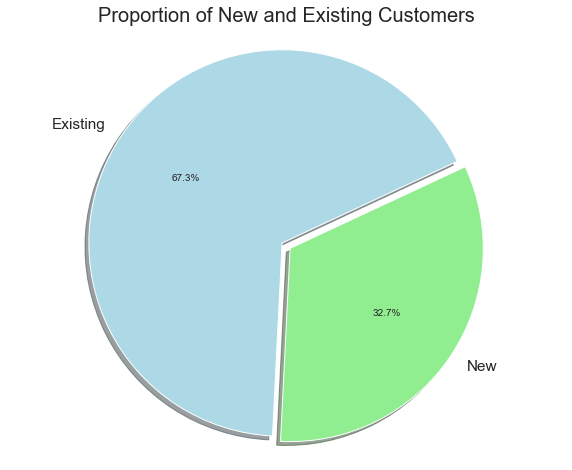

In [584]:
labels = 'Existing', 'New'
sizes = [stc.SPRNewExisting[stc["SPRNewExisting"]=='EXISTING'].count(), stc.SPRNewExisting[stc["SPRNewExisting"]=='NEW'].count()]
explode = (0, 0.05)
my_colors = ['lightblue','lightgreen']
fig1, ax1 = plt.subplots(figsize=(10, 8))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',shadow=True, startangle=25,colors=my_colors)
ax1.axis('equal')
plt.title("Proportion of New and Existing Customers", size = 20)
plt.show()

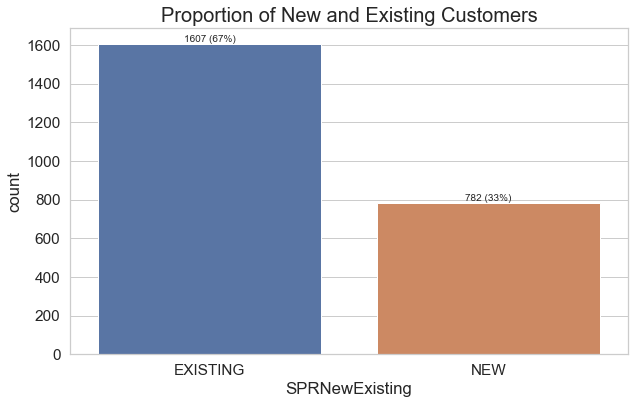

In [585]:

fig = plt.figure(figsize=(10,6))
sns.countplot(x ='SPRNewExisting', data = stc)
 
    
ax = sns.countplot(x=stc['SPRNewExisting'],
                   order=stc['SPRNewExisting'].value_counts(ascending=False).index);        
abs_values = stc['SPRNewExisting'].value_counts(ascending=False)
rel_values = stc['SPRNewExisting'].value_counts(ascending=False, normalize=True).values * 100
lbls = [f'{p[0]} ({p[1]:.0f}%)' for p in zip(abs_values, rel_values)]
ax.bar_label(container=ax.containers[0], labels=lbls)    
    
    
plt.title("Proportion of New and Existing Customers", size = 20)
plt.show()

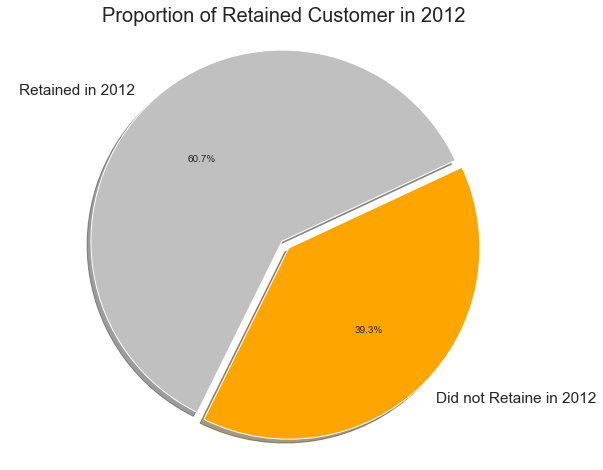

   Retainedin2012
1            1451
0             938


In [586]:
labels = 'Retained in 2012', 'Did not Retaine in 2012'
sizes = [stc.Retainedin2012[stc["Retainedin2012"]==1].count(), stc.Retainedin2012[stc["Retainedin2012"]==0].count()]
explode = (0, 0.05)
my_colors = ['silver','orange']
fig1, ax1 = plt.subplots(figsize=(10, 8))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',shadow=True, startangle=25,colors=my_colors)
ax1.axis('equal')
plt.title("Proportion of Retained Customer in 2012 ", size = 20)
plt.show()
print(pd.DataFrame(stc["Retainedin2012"].value_counts()))

Text(0, 0.5, 'Count')

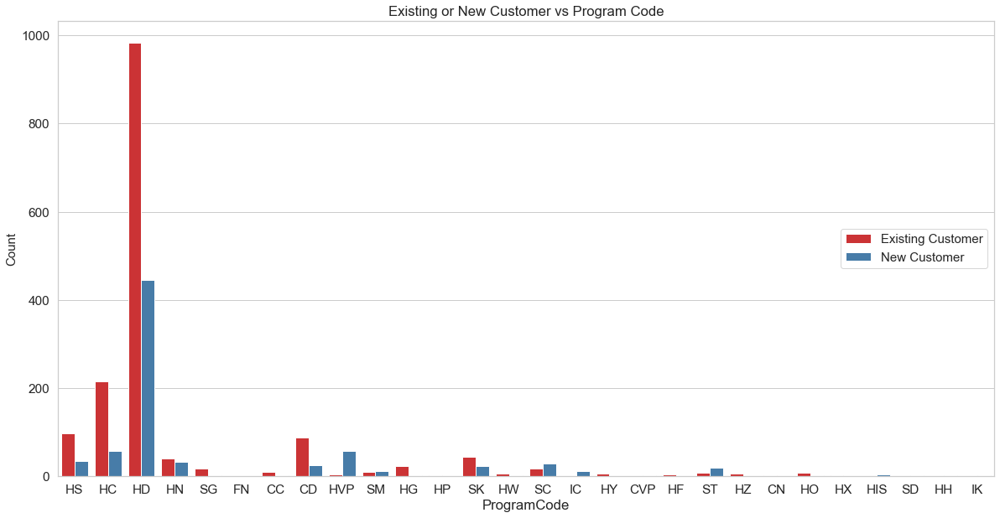

In [588]:
plt.figure(figsize=(20,10))
sns.countplot(x="ProgramCode",hue="SPRNewExisting", data=stc, palette="Set1")






plt.title("Existing or New Customer vs Program Code")
plt.legend(['Existing Customer','New Customer'],fontsize=15,loc=5)
plt.ylabel("Count",fontsize=15)
#plt.legend()

Text(0, 0.5, 'Count')

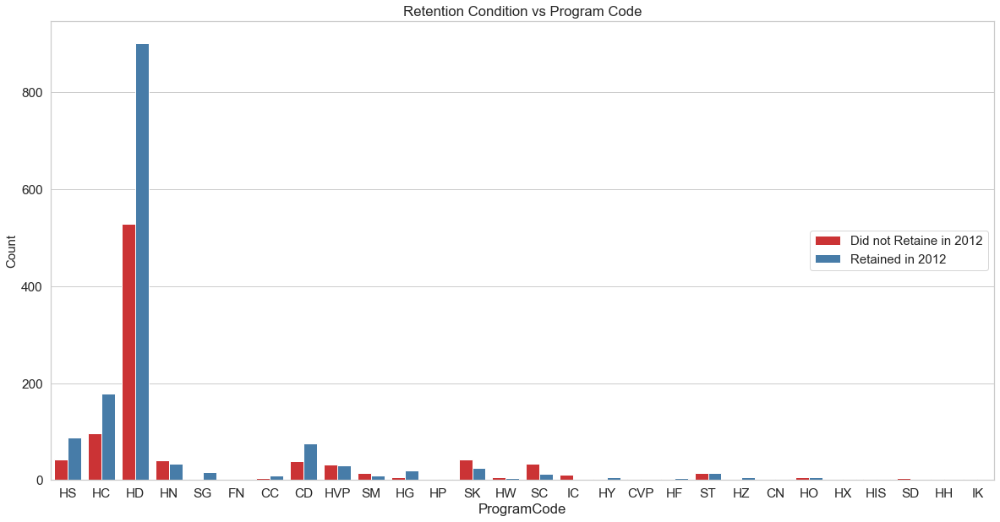

In [589]:
plt.figure(figsize=(20,10))
sns.countplot(x="ProgramCode",hue="Retainedin2012", data=stc, palette="Set1")


plt.title("Retention Condition vs Program Code")
plt.legend(['Did not Retaine in 2012','Retained in 2012'],fontsize=15,loc=5)
plt.ylabel("Count",fontsize=15)
#plt.legend()

In [590]:
stc.head()

,ID,ProgramCode,FromGrade,ToGrade,GroupState,IsNonAnnual,Days,TravelType,DepartureDate,ReturnDate,DepositDate,SpecialPay,Tuition,FRPActive,FRPCancelled,FRPTakeuppercent,EarlyRPL,LatestRPL,CancelledPax,TotalDiscountPax,InitialSystemDate,PovertyCode,Region,CRMSegment,SchoolType,ParentMeetingFlag,MDRLowGrade,MDRHighGrade,TotalSchoolEnrollment,IncomeLevel,EZPayTakeUpRate,SchoolSponsor,SPRProductType,SPRNewExisting,FPP,TotalPax,SPRGroupRevenue,NumberOfMeetingswithParents,FirstMeeting,LastMeeting,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SchoolGradeTypeLow,SchoolGradeTypeHigh,SchoolGradeType,DepartureMonth,GroupGradeTypeLow,GroupGradeTypeHigh,GroupGradeType,MajorProgramCode,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,NumofNon_FPPPAX,SchoolSizeIndicator,Retainedin2012,DepositdaysbeforeDeparture
0,1,HS,4.0,4.0,CA,0,1,A,2011-01-14,2011-01-14,2010-08-30,NaN,424,25,3,0.424,2010-03-29,2010-08-12,3,4,2010-03-26,B,Southern California,4.0,PUBLIC,1,K,5.0,927.0,Q,0.170,1,CA History,EXISTING,59,63,424,1,2010-08-12,2010-08-12,155.0,155.0,Elementary,Elementary,Elementary->Elementary,January,K,Elementary,K->Elementary,H,1,0.063646,0.936508,4,L,1,137
1,2,HC,8.0,8.0,AZ,0,7,A,2011-01-14,2011-01-21,2009-11-15,CP,2350,9,9,0.409,2009-10-20,2010-08-10,11,3,2009-10-02,C,Other,10.0,PUBLIC,1,7,8.0,850.0,A,0.091,0,East Coast,EXISTING,22,25,2350,2,2009-11-17,2010-08-27,423.0,140.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,1,0.025882,0.880000,3,L,1,425
2,3,HD,8.0,8.0,FL,0,3,A,2011-01-15,2011-01-17,2010-10-15,NaN,1181,17,6,0.708,2010-04-29,2010-08-16,6,3,2010-01-28,C,Other,10.0,PUBLIC,1,6,8.0,955.0,O,0.042,0,East Coast,EXISTING,24,27,1181,1,2010-09-13,2010-09-13,124.0,124.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,1,0.025131,0.888889,3,L,1,92
3,4,HN,9.0,12.0,VA,1,3,B,2011-01-15,2011-01-17,2011-01-07,NaN,376,0,0,0.000,NaN,NaN,1,0,2010-10-19,NaN,Other,7.0,CHD,0,NaN,NaN,NaN,NaN,0.000,0,East Coast,EXISTING,18,18,376,0,NaT,NaT,NaN,NaN,High,High,High->High,January,Undefined,Undefined,Undefined->Undefined,H,0,NaN,1.000000,0,NaN,0,8
4,5,HD,6.0,8.0,FL,0,6,T,2011-01-16,2011-01-21,2010-09-30,NaN,865,40,8,0.494,2010-03-29,2010-08-12,9,8,2010-03-23,D,Other,10.0,PUBLIC,1,6,8.0,720.0,C,0.383,0,East Coast,EXISTING,81,89,865,1,2010-08-24,2010-08-24,145.0,145.0,Middle,Middle,Middle->Middle,January,Middle,Middle,Middle->Middle,H,0,0.112500,0.910112,8,M-L,0,108


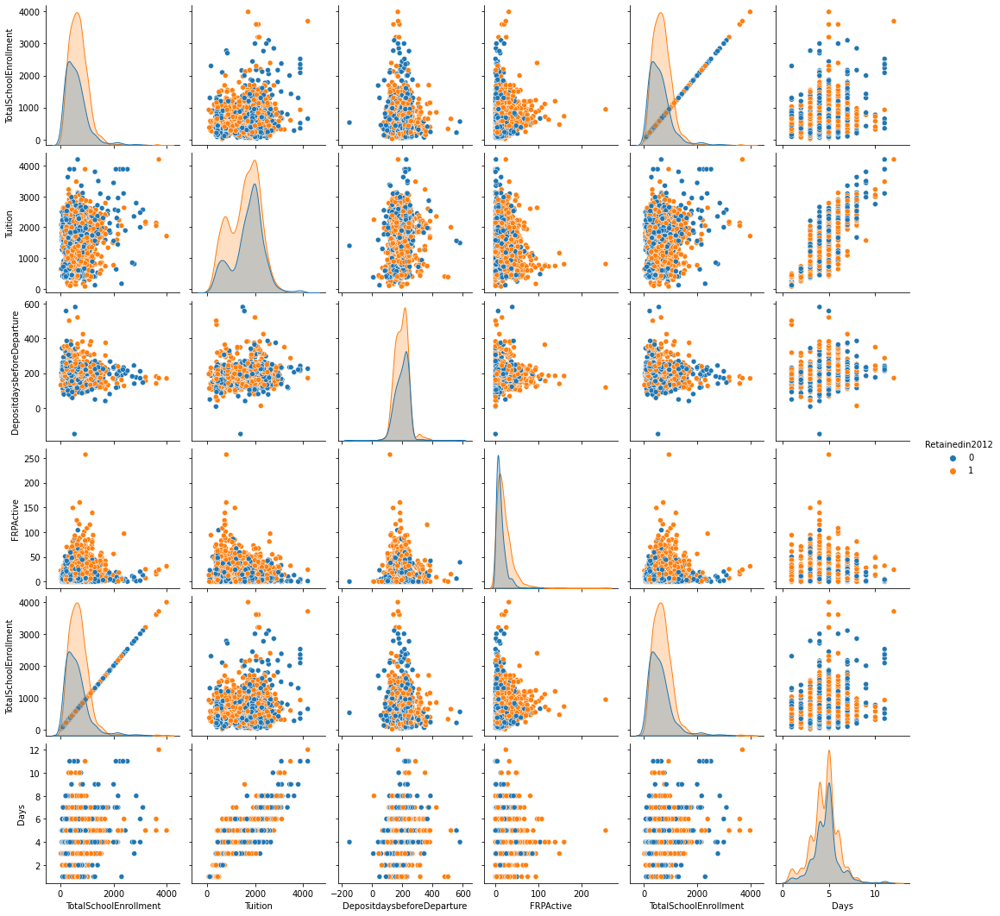

In [19]:
sns.pairplot(stc,hue='Retainedin2012',vars=['TotalSchoolEnrollment','Tuition','DepositdaysbeforeDeparture','FRPActive','TotalSchoolEnrollment','Days'])

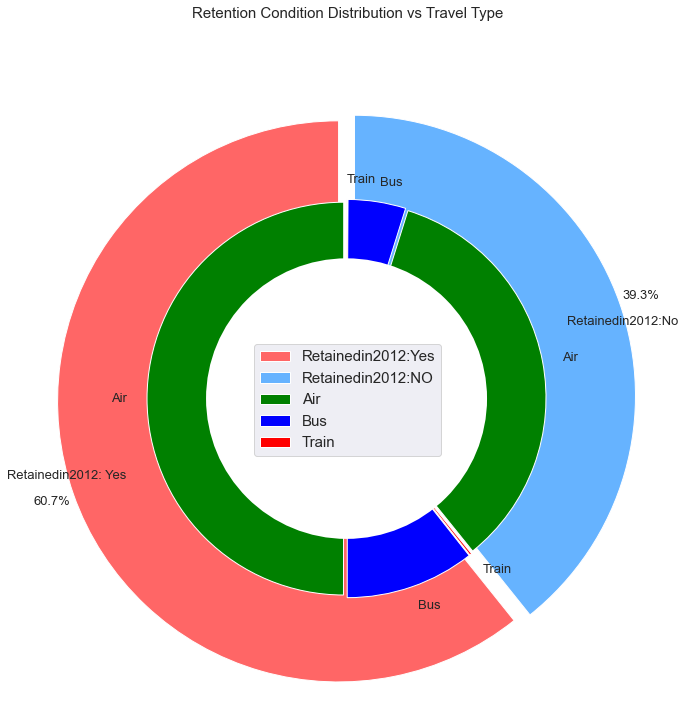

In [744]:
plt.figure(figsize=(10, 10))
labels =["Retainedin2012: Yes","Retainedin2012:No"]
values = [1451,938]
labels_gender = ["Air","Bus","Train","Air","Bus","Train"]
sizes_traveltype = [1193,254 ,4,821,113,2]
colors = ['#ff6666', '#66b3ff']
colors_gender = ['green','blue','red', 'green','blue','red']
explode = (0.3,0.3) 
explode_gender = (0.1,0.1,0.1,0.1,0.1,0.1)
textprops = {"fontsize":13}
#Plot
plt.pie(values, labels=labels,autopct='%1.1f%%',pctdistance=1.08, labeldistance=0.8,colors=colors, startangle=90,frame=True, explode=explode,radius=10, textprops =textprops, counterclock = True, )
plt.pie(sizes_traveltype,labels=labels_gender,colors=colors_gender,startangle=90, explode=explode_gender,radius=7, textprops =textprops, counterclock = True, )
#Draw circle
centre_circle = plt.Circle((0,0),5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Retention Condition Distribution vs Travel Type', fontsize=15, y=1.1)

# show plot 
 
plt.axis('equal')
plt.tight_layout()
#plt.legend(loc=10)
plt.legend(loc = 0, prop = {'size': 15})
plt.legend(["Retainedin2012:Yes", "Retainedin2012:NO","Air", "Bus",'Train'],loc = 10, prop = {'size': 15})

plt.show()

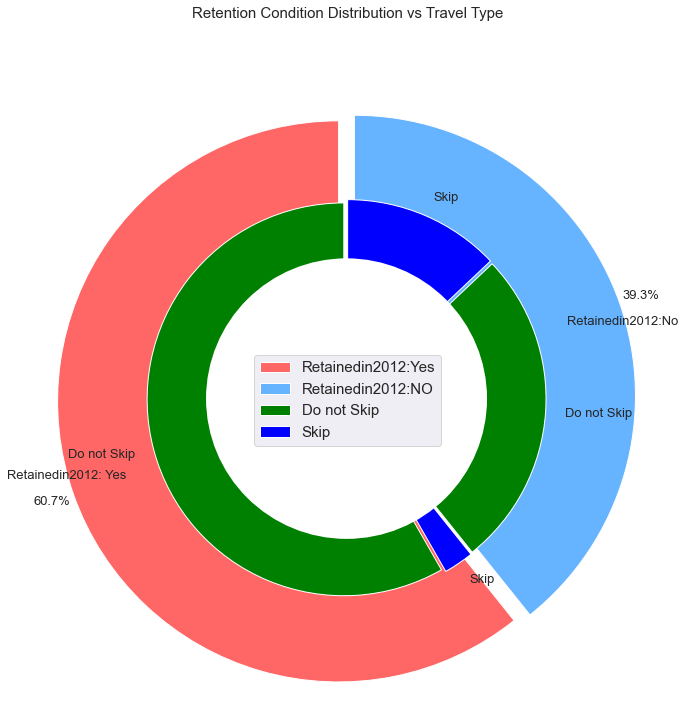

In [745]:

plt.figure(figsize=(10, 10))
labels =["Retainedin2012: Yes","Retainedin2012:No"]
values = [1451,938]
labels_gender = ["Do not Skip","Skip","Do not Skip","Skip"]
sizes_traveltype = [1392,59,629,309]
colors = ['#ff6666', '#66b3ff']
colors_gender = ['green','blue']
explode = (0.3,0.3) 
explode_gender = (0.1,0.1,0.1,0.1)
textprops = {"fontsize":13}
#Plot
plt.pie(values, labels=labels,autopct='%1.1f%%',pctdistance=1.08, labeldistance=0.8,colors=colors, startangle=90,frame=True, explode=explode,radius=10, textprops =textprops, counterclock = True, )
plt.pie(sizes_traveltype,labels=labels_gender,colors=colors_gender,startangle=90, explode=explode_gender,radius=7, textprops =textprops, counterclock = True, )
#Draw circle
centre_circle = plt.Circle((0,0),5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Retention Condition Distribution vs Travel Type', fontsize=15, y=1.1)

# show plot 
 
plt.axis('equal')
plt.tight_layout()
#plt.legend(loc=10)
plt.legend(loc = 0, prop = {'size': 15})
plt.legend(["Retainedin2012:Yes", "Retainedin2012:NO","Do not Skip", "Skip"],loc = 10, prop = {'size': 15})

plt.show()

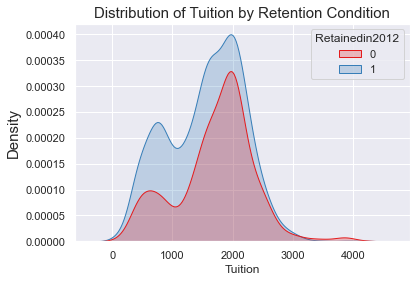

In [746]:
sns.set_style("darkgrid")
sns.kdeplot(x="Tuition",data=stc,palette="Set1",hue="Retainedin2012",shade=True)
sns.set(rc={'figure.figsize':(20,12)})
plt.ylabel('Density',fontsize=15);
#plt.xlabel('Tuition',fontsize=15);


plt.title('Distribution of Tuition by Retention Condition',fontsize=15);

In [747]:
#Both Retained and Non Retained customers have similar distribution with regard to Paid Tuition

# Feature Engineering (Feature Selection)

# 1 Remove Column with most Nan Values

In [248]:
stc.isnull().sum()

ID                                   0
ProgramCode                          0
FromGrade                          127
ToGrade                            150
GroupState                           0
IsNonAnnual                          0
Days                                 0
TravelType                           0
DepartureDate                        0
ReturnDate                           0
DepositDate                          0
SpecialPay                        1919
Tuition                              0
FRPActive                            0
FRPCancelled                         0
FRPTakeuppercent                     0
EarlyRPL                           673
LatestRPL                           19
CancelledPax                         0
TotalDiscountPax                     0
InitialSystemDate                    8
PovertyCode                        599
Region                               0
CRMSegment                           4
SchoolType                           0
ParentMeetingFlag        

In [923]:
stc=stc.drop(['SpecialPay','EarlyRPL','LatestRPL'], axis=1)

# 2 Remove Collinear Variables

# Collinearity is a very common problem in machine learning projects
# It is the correlation between the features of a dataset and it can reduce the performance of our 
# models because it increases variance and the number of dimensions
# We have removed collinear variables as part of the data preparation process 
# and eliminating variables that are above a certain threshold. For our project We select this threshold to be 70%

In [251]:
len(stc.columns)

54

In [925]:
stc.corr()

,ID,FromGrade,ToGrade,IsNonAnnual,Days,Tuition,FRPActive,FRPCancelled,FRPTakeuppercent,CancelledPax,TotalDiscountPax,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,EZPayTakeUpRate,SchoolSponsor,FPP,TotalPax,SPRGroupRevenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,NumofNon_FPPPAX,Retainedin2012,DepositdaysbeforeDeparture
ID,1.000000,-0.045124,0.067944,0.004484,0.061590,0.106021,-0.166402,-0.037480,0.057740,0.000683,-0.158681,0.057880,-0.006338,-0.022283,-0.001134,0.137619,-0.123450,-0.187488,-0.187344,0.106021,0.012682,0.405851,0.566948,-0.166959,-0.114203,-0.126038,-0.158681,-0.148490,0.603347
FromGrade,-0.045124,1.000000,0.779775,-0.107391,0.402515,0.313262,0.094622,0.076536,0.133030,0.062403,0.151813,0.246724,0.127055,0.487057,0.186064,0.055754,-0.315270,0.031089,0.042538,0.313262,0.089202,-0.032032,-0.040250,0.196779,-0.062839,-0.122717,0.151813,0.083220,0.007250
ToGrade,0.067944,0.779775,1.000000,0.092553,0.440916,0.414692,-0.063830,0.029503,0.154540,0.048955,0.014050,0.232147,0.143847,0.581006,0.161579,0.055798,-0.370151,-0.140358,-0.128152,0.414692,0.134745,0.046226,0.028065,-0.322935,-0.107073,-0.246170,0.014050,-0.200470,0.046344
IsNonAnnual,0.004484,-0.107391,0.092553,1.000000,0.019720,0.056052,-0.033359,-0.009289,0.061712,-0.020190,-0.060039,0.039884,0.043010,0.046171,-0.134376,0.061965,-0.003663,-0.072195,-0.072043,0.056052,0.063371,0.111056,0.064330,-0.352164,0.075935,0.020026,-0.060039,-0.390633,0.059349
Days,0.061590,0.402515,0.440916,0.019720,1.000000,0.772086,-0.037300,0.058620,0.069282,0.052793,-0.001338,-0.018599,0.142625,0.242661,0.135481,0.066963,-0.222797,-0.116036,-0.107127,0.772086,0.127983,0.088838,0.053798,-0.117656,-0.109527,-0.173382,-0.001338,-0.049402,0.104473
Tuition,0.106021,0.313262,0.414692,0.056052,0.772086,1.000000,-0.225533,-0.007369,0.175085,-0.026192,-0.218439,-0.073536,0.157659,0.178791,0.147744,0.098941,-0.246801,-0.364922,-0.356411,1.000000,0.153833,0.130842,0.102268,-0.179277,-0.277246,-0.294471,-0.218439,-0.119015,0.113786
FRPActive,-0.166402,0.094622,-0.063830,-0.033359,-0.037300,-0.225533,1.000000,0.463491,0.269307,0.383178,0.698390,0.027741,0.068607,-0.013089,0.091351,0.108399,0.078897,0.815323,0.815460,-0.225533,0.000334,-0.120211,-0.105919,0.213394,0.393675,0.261698,0.698390,0.250478,-0.054787
FRPCancelled,-0.037480,0.076536,0.029503,-0.009289,0.058620,-0.007369,0.463491,1.000000,0.180026,0.850347,0.323035,0.038990,0.132144,-0.039826,0.133532,0.107432,-0.032677,0.341100,0.343967,-0.007369,0.107907,0.029818,0.027411,0.059500,0.091254,0.045080,0.323035,0.072659,0.012705
FRPTakeuppercent,0.057740,0.133030,0.154540,0.061712,0.069282,0.175085,0.269307,0.180026,1.000000,0.054446,-0.095357,0.110619,0.180718,0.043401,0.047478,0.264187,-0.202375,-0.147954,-0.145122,0.175085,0.142427,0.064169,0.072920,-0.063694,-0.148195,-0.113037,-0.095357,-0.016665,0.051820
CancelledPax,0.000683,0.062403,0.048955,-0.020190,0.052793,-0.026192,0.383178,0.850347,0.054446,1.000000,0.349456,0.056438,0.102987,-0.036039,0.153521,0.000268,-0.032776,0.355639,0.359780,-0.026192,0.090051,0.039739,0.047998,0.021533,0.095976,0.029998,0.349456,0.048998,0.034932


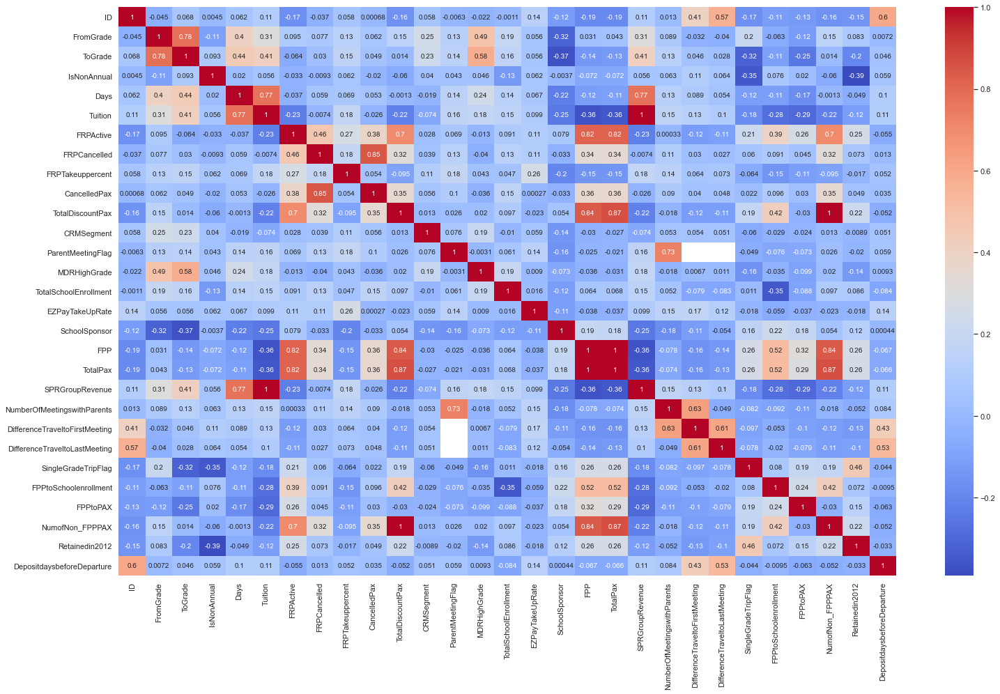

In [926]:
fig=plt.figure(figsize=(25,15))
sns.heatmap(stc.corr(),cmap='coolwarm',annot=True);
fig.savefig("cor.png", dpi=100)

In [927]:
threshold = 0.7
corr_matrix = stc.corr().abs()
corr_matrix.head()

,ID,FromGrade,ToGrade,IsNonAnnual,Days,Tuition,FRPActive,FRPCancelled,FRPTakeuppercent,CancelledPax,TotalDiscountPax,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,EZPayTakeUpRate,SchoolSponsor,FPP,TotalPax,SPRGroupRevenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,NumofNon_FPPPAX,Retainedin2012,DepositdaysbeforeDeparture
ID,1.000000,0.045124,0.067944,0.004484,0.061590,0.106021,0.166402,0.037480,0.057740,0.000683,0.158681,0.057880,0.006338,0.022283,0.001134,0.137619,0.123450,0.187488,0.187344,0.106021,0.012682,0.405851,0.566948,0.166959,0.114203,0.126038,0.158681,0.148490,0.603347
FromGrade,0.045124,1.000000,0.779775,0.107391,0.402515,0.313262,0.094622,0.076536,0.133030,0.062403,0.151813,0.246724,0.127055,0.487057,0.186064,0.055754,0.315270,0.031089,0.042538,0.313262,0.089202,0.032032,0.040250,0.196779,0.062839,0.122717,0.151813,0.083220,0.007250
ToGrade,0.067944,0.779775,1.000000,0.092553,0.440916,0.414692,0.063830,0.029503,0.154540,0.048955,0.014050,0.232147,0.143847,0.581006,0.161579,0.055798,0.370151,0.140358,0.128152,0.414692,0.134745,0.046226,0.028065,0.322935,0.107073,0.246170,0.014050,0.200470,0.046344
IsNonAnnual,0.004484,0.107391,0.092553,1.000000,0.019720,0.056052,0.033359,0.009289,0.061712,0.020190,0.060039,0.039884,0.043010,0.046171,0.134376,0.061965,0.003663,0.072195,0.072043,0.056052,0.063371,0.111056,0.064330,0.352164,0.075935,0.020026,0.060039,0.390633,0.059349
Days,0.061590,0.402515,0.440916,0.019720,1.000000,0.772086,0.037300,0.058620,0.069282,0.052793,0.001338,0.018599,0.142625,0.242661,0.135481,0.066963,0.222797,0.116036,0.107127,0.772086,0.127983,0.088838,0.053798,0.117656,0.109527,0.173382,0.001338,0.049402,0.104473


In [928]:
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper.head()

<ipython-input-928-c90561697f1e>:1: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,ID,FromGrade,ToGrade,IsNonAnnual,Days,Tuition,FRPActive,FRPCancelled,FRPTakeuppercent,CancelledPax,TotalDiscountPax,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,EZPayTakeUpRate,SchoolSponsor,FPP,TotalPax,SPRGroupRevenue,NumberOfMeetingswithParents,DifferenceTraveltoFirstMeeting,DifferenceTraveltoLastMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,NumofNon_FPPPAX,Retainedin2012,DepositdaysbeforeDeparture
ID,NaN,0.045124,0.067944,0.004484,0.061590,0.106021,0.166402,0.037480,0.057740,0.000683,0.158681,0.057880,0.006338,0.022283,0.001134,0.137619,0.123450,0.187488,0.187344,0.106021,0.012682,0.405851,0.566948,0.166959,0.114203,0.126038,0.158681,0.148490,0.603347
FromGrade,NaN,NaN,0.779775,0.107391,0.402515,0.313262,0.094622,0.076536,0.133030,0.062403,0.151813,0.246724,0.127055,0.487057,0.186064,0.055754,0.315270,0.031089,0.042538,0.313262,0.089202,0.032032,0.040250,0.196779,0.062839,0.122717,0.151813,0.083220,0.007250
ToGrade,NaN,NaN,NaN,0.092553,0.440916,0.414692,0.063830,0.029503,0.154540,0.048955,0.014050,0.232147,0.143847,0.581006,0.161579,0.055798,0.370151,0.140358,0.128152,0.414692,0.134745,0.046226,0.028065,0.322935,0.107073,0.246170,0.014050,0.200470,0.046344
IsNonAnnual,NaN,NaN,NaN,NaN,0.019720,0.056052,0.033359,0.009289,0.061712,0.020190,0.060039,0.039884,0.043010,0.046171,0.134376,0.061965,0.003663,0.072195,0.072043,0.056052,0.063371,0.111056,0.064330,0.352164,0.075935,0.020026,0.060039,0.390633,0.059349
Days,NaN,NaN,NaN,NaN,NaN,0.772086,0.037300,0.058620,0.069282,0.052793,0.001338,0.018599,0.142625,0.242661,0.135481,0.066963,0.222797,0.116036,0.107127,0.772086,0.127983,0.088838,0.053798,0.117656,0.109527,0.173382,0.001338,0.049402,0.104473


In [929]:
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))
to_drop

There are 8 columns to remove.


['ToGrade',
 'Tuition',
 'CancelledPax',
 'FPP',
 'TotalPax',
 'SPRGroupRevenue',
 'NumberOfMeetingswithParents',
 'NumofNon_FPPPAX']

In [930]:
stc = stc.drop(columns = to_drop)
print('Training shape: ', stc.shape)


Training shape:  (2389, 46)


# 3 Removing Columns by Correlation With Response Variable

In [931]:
stc2=stc.drop(columns = ['ID','Retainedin2012'])
correlations = stc2.corrwith(stc.Retainedin2012)
correlations = correlations[correlations!=1]
positive_correlations = correlations[
correlations >0].sort_values(ascending = False)
negative_correlations =correlations[
correlations<0].sort_values(ascending = False)
print('Most Positive Correlations: \n', positive_correlations)
print('\nMost Negative Correlations: \n', negative_correlations)

Most Positive Correlations: 
 SingleGradeTripFlag      0.455872
FRPActive                0.250478
TotalDiscountPax         0.216218
FPPtoPAX                 0.145107
SchoolSponsor            0.120717
TotalSchoolEnrollment    0.085860
FromGrade                0.083220
FRPCancelled             0.072659
FPPtoSchoolenrollment    0.071679
dtype: float64

Most Negative Correlations: 
 CRMSegment                       -0.008913
FRPTakeuppercent                 -0.016665
EZPayTakeUpRate                  -0.018060
ParentMeetingFlag                -0.020481
DepositdaysbeforeDeparture       -0.032939
Days                             -0.049402
DifferenceTraveltoLastMeeting    -0.103564
DifferenceTraveltoFirstMeeting   -0.130223
MDRHighGrade                     -0.135009
IsNonAnnual                      -0.390633
dtype: float64


<AxesSubplot:title={'center':'Correlation With Response Variable (Retainedin2012)'}>

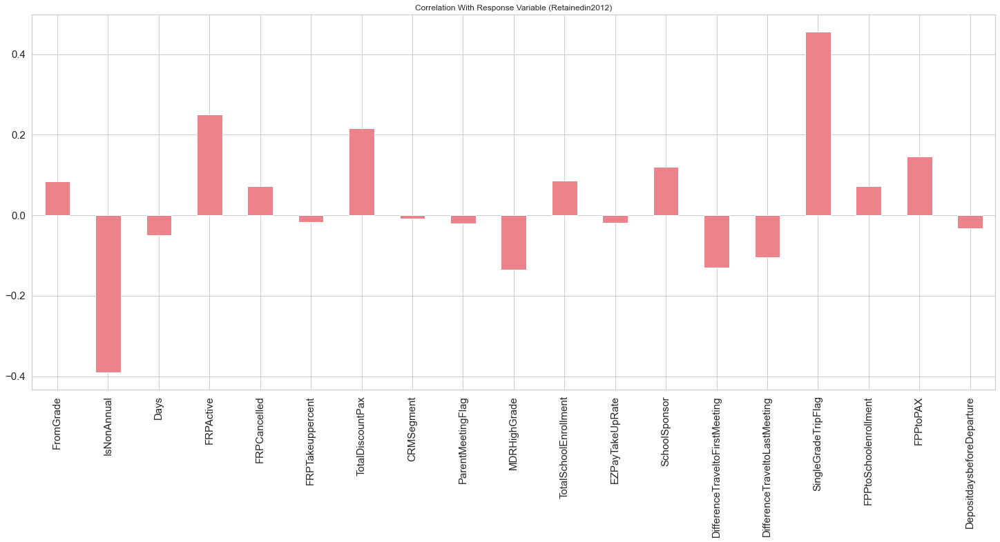

In [932]:
correlations = stc2.corrwith(stc.Retainedin2012)
correlations = correlations[correlations!=1]
correlations.plot.bar(
        figsize = (25, 10), 
        
        color = '#ec838a',
        rot = 90, grid = True,title='Correlation With Response Variable (Retainedin2012)', fontsize=15)

# Interestingly, the Retantion rate increases when 1)full refund is active 2) If students were from the same gradeIf the school is sponsering the trip 4) .In contrast 1)Days (the shortest the trip the most likely to retain) 2) In non Annual....seem to be negatively related to churn

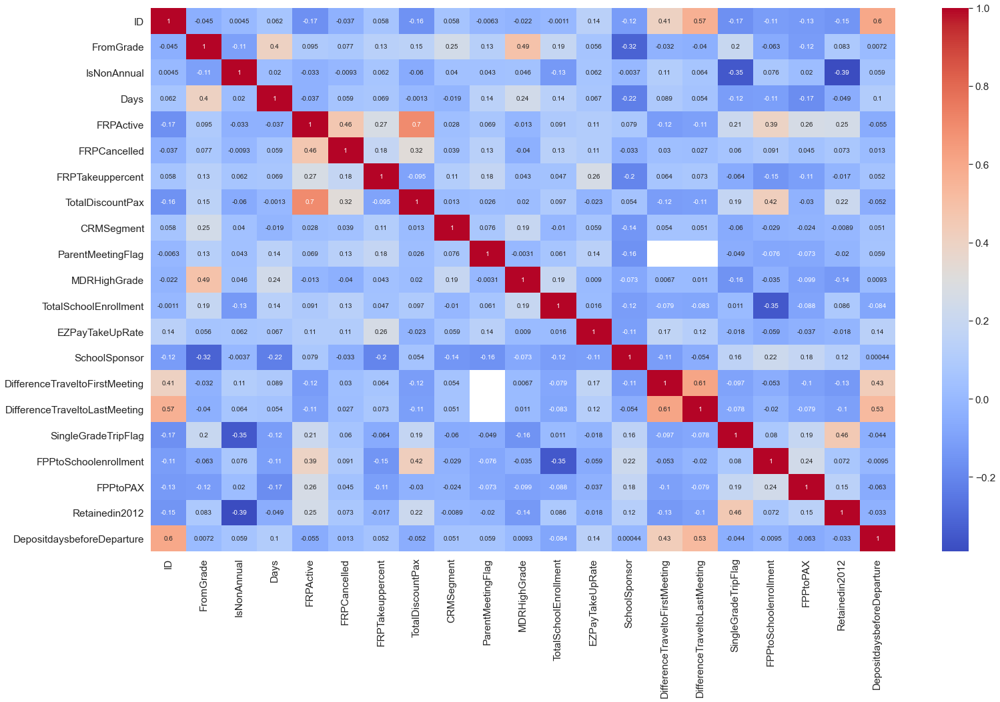

In [604]:
fig=plt.figure(figsize=(25,15))
sns.heatmap(stc.corr(),cmap='coolwarm',annot=True);

<ipython-input-933-ad975f9dc34c>:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(corr, dtype=np.bool)


<AxesSubplot:>

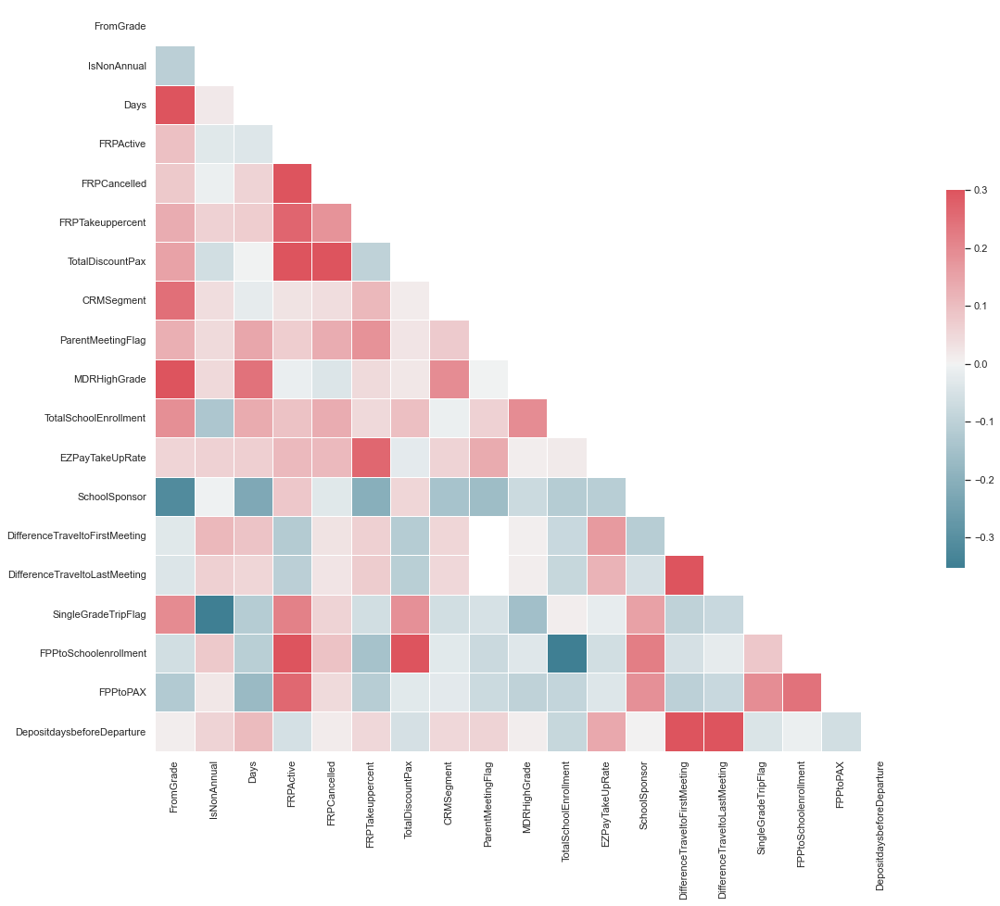

In [933]:
sns.set(style="white")
corr = stc2.corr()
#Generate a mask for the upper triangle:
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
#Set up the matplotlib figure and a diverging colormap:
f, ax = plt.subplots(figsize=(18, 15))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
#Draw the heatmap with the mask and correct aspect ratio:
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
square=True, linewidths=.5, cbar_kws={"shrink": .5})


In [606]:
stc2.columns

Index(['ProgramCode', 'FromGrade', 'GroupState', 'IsNonAnnual', 'Days',
       'TravelType', 'DepartureDate', 'ReturnDate', 'DepositDate', 'FRPActive',
       'FRPCancelled', 'FRPTakeuppercent', 'TotalDiscountPax',
       'InitialSystemDate', 'PovertyCode', 'Region', 'CRMSegment',
       'SchoolType', 'ParentMeetingFlag', 'MDRLowGrade', 'MDRHighGrade',
       'TotalSchoolEnrollment', 'IncomeLevel', 'EZPayTakeUpRate',
       'SchoolSponsor', 'SPRProductType', 'SPRNewExisting', 'FirstMeeting',
       'LastMeeting', 'DifferenceTraveltoFirstMeeting',
       'DifferenceTraveltoLastMeeting', 'SchoolGradeTypeLow',
       'SchoolGradeTypeHigh', 'SchoolGradeType', 'DepartureMonth',
       'GroupGradeTypeLow', 'GroupGradeTypeHigh', 'GroupGradeType',
       'MajorProgramCode', 'SingleGradeTripFlag', 'FPPtoSchoolenrollment',
       'FPPtoPAX', 'SchoolSizeIndicator', 'DepositdaysbeforeDeparture'],
      dtype='object')

By removing the value that has the most correlation with other, we wont lose the value of that, because we will
still have the other value. For example: FRPCancelled is highly correlated with FRPActive. By removing one of them,
We can its value still exist in the other value
Moreover, the highly correlated values are removed

In [963]:
stc=stc.drop(columns=['FRPCancelled','DifferenceTraveltoLastMeeting','FromGrade','TotalDiscountPax'])

KeyError: "['FRPCancelled' 'DifferenceTraveltoLastMeeting' 'FromGrade'\n 'TotalDiscountPax'] not found in axis"

In [964]:
len(stc.columns)

42

# 4 Treat Missing Values

# 4-1 For Numeric Values, Filling nan with Mean of its column 

In [935]:
stc['TotalSchoolEnrollment'].mean()
stc['TotalSchoolEnrollment'].fillna(stc['TotalSchoolEnrollment'].mean(), inplace=True)
stc['TotalSchoolEnrollment'].fillna(stc['TotalSchoolEnrollment'].mean(),inplace=True)
stc['TotalSchoolEnrollment'].isnull().sum()

0

In [936]:
stc['CRMSegment'].mean()
stc['CRMSegment'].fillna(stc['CRMSegment'].mean(), inplace=True)
stc['CRMSegment'].fillna(stc['CRMSegment'].mean(),inplace=True)
stc['CRMSegment'].isnull().sum()

0

In [937]:
stc['FPPtoSchoolenrollment'].mean()
stc['FPPtoSchoolenrollment'].fillna(stc['FPPtoSchoolenrollment'].mean(), inplace=True)
stc['FPPtoSchoolenrollment'].fillna(stc['FPPtoSchoolenrollment'].mean(),inplace=True)
stc['FPPtoSchoolenrollment'].isnull().sum()



0

In [938]:
stc['MDRHighGrade'].mean()
stc['MDRHighGrade'].fillna(stc['MDRHighGrade'].mean(), inplace=True)
stc['MDRHighGrade'].fillna(stc['MDRHighGrade'].mean(),inplace=True)
stc['MDRHighGrade'].isnull().sum()


0

# 4-2 For Cathegorical Values, Filling nan with Mode of its column 

In [939]:
stc['IncomeLevel'].fillna(stc['IncomeLevel'].value_counts().index[0],inplace=True)
stc['IncomeLevel'].isnull().sum()

0

In [940]:
stc['SchoolSizeIndicator'].fillna(stc['SchoolSizeIndicator'].value_counts().index[0],inplace=True)
stc['SchoolSizeIndicator'].isnull().sum()

0

In [941]:
stc['PovertyCode'].fillna(stc['PovertyCode'].value_counts().index[0],inplace=True)
stc['PovertyCode'].isnull().sum()

0

# 4-3 Filling Nan in Date Columns with next availible non-Nan Value

In [942]:
stc[['InitialSystemDate','MDRLowGrade','FirstMeeting','LastMeeting','DifferenceTraveltoFirstMeeting']]=stc[['InitialSystemDate','MDRLowGrade','FirstMeeting','LastMeeting','DifferenceTraveltoFirstMeeting']]=stc[['InitialSystemDate','MDRLowGrade','FirstMeeting','LastMeeting','DifferenceTraveltoFirstMeeting']].fillna(method='ffill')

In [886]:
stc.nunique()

ID                                2389
ProgramCode                         28
GroupState                          54
IsNonAnnual                          2
Days                                12
TravelType                           4
DepartureDate                      144
ReturnDate                         143
DepositDate                        135
FRPActive                           93
FRPTakeuppercent                   476
InitialSystemDate                  296
PovertyCode                          6
Region                               6
CRMSegment                          12
SchoolType                           4
ParentMeetingFlag                    2
MDRLowGrade                         12
MDRHighGrade                        13
TotalSchoolEnrollment              894
IncomeLevel                         22
EZPayTakeUpRate                    371
SchoolSponsor                        2
SPRProductType                       6
SPRNewExisting                       2
FirstMeeting             

In [75]:
stc.isna().any()

ID                                False
ProgramCode                       False
GroupState                        False
IsNonAnnual                       False
Days                              False
TravelType                        False
DepartureDate                     False
ReturnDate                        False
DepositDate                       False
FRPActive                         False
FRPTakeuppercent                  False
InitialSystemDate                 False
PovertyCode                       False
Region                            False
CRMSegment                        False
SchoolType                        False
ParentMeetingFlag                 False
MDRLowGrade                       False
MDRHighGrade                      False
TotalSchoolEnrollment             False
IncomeLevel                       False
EZPayTakeUpRate                   False
SchoolSponsor                     False
SPRProductType                    False
SPRNewExisting                    False


In [76]:
# We ended up with a dataset with 46 columns

# Applying Classification Algotithm 

In [548]:
len(stc.columns)

42

In [550]:
stc.columns

Index(['ID', 'ProgramCode', 'GroupState', 'IsNonAnnual', 'Days', 'TravelType',
       'DepartureDate', 'ReturnDate', 'DepositDate', 'FRPActive',
       'FRPTakeuppercent', 'InitialSystemDate', 'PovertyCode', 'Region',
       'CRMSegment', 'SchoolType', 'ParentMeetingFlag', 'MDRLowGrade',
       'MDRHighGrade', 'TotalSchoolEnrollment', 'IncomeLevel',
       'EZPayTakeUpRate', 'SchoolSponsor', 'SPRProductType', 'SPRNewExisting',
       'FirstMeeting', 'LastMeeting', 'DifferenceTraveltoFirstMeeting',
       'SchoolGradeTypeLow', 'SchoolGradeTypeHigh', 'SchoolGradeType',
       'DepartureMonth', 'GroupGradeTypeLow', 'GroupGradeTypeHigh',
       'GroupGradeType', 'MajorProgramCode', 'SingleGradeTripFlag',
       'FPPtoSchoolenrollment', 'FPPtoPAX', 'SchoolSizeIndicator',
       'Retainedin2012', 'DepositdaysbeforeDeparture'],
      dtype='object')

# Choose the Propper Columns

# For Classification Analysis we ignored Date Columns

# Some other Columns are removed

In [721]:
#stc2=stc.drop(columns = ['InitialSystemDate','DepositDate','DepartureDate','ReturnDate','FirstMeeting','LastMeeting','GroupGradeType','GroupGradeTypeHigh','GroupGradeTypeLow','SchoolGradeTypeHigh','SchoolGradeTypeLow','MDRLowGrade','DifferenceTraveltoFirstMeeting'])

In [1014]:
stc3=stc.drop(columns = ['GroupGradeType','GroupGradeTypeHigh','GroupGradeTypeLow','SchoolGradeTypeHigh','SchoolGradeTypeLow','MDRLowGrade','DepartureDate','ReturnDate','DepositDate','InitialSystemDate','FirstMeeting','LastMeeting'])

In [1015]:
len(stc3.columns)

30

In [702]:
stc3.columns

Index(['ID', 'ProgramCode', 'GroupState', 'IsNonAnnual', 'Days', 'TravelType',
       'FRPActive', 'FRPTakeuppercent', 'PovertyCode', 'Region', 'CRMSegment',
       'SchoolType', 'ParentMeetingFlag', 'MDRHighGrade',
       'TotalSchoolEnrollment', 'IncomeLevel', 'EZPayTakeUpRate',
       'SchoolSponsor', 'SPRProductType', 'SPRNewExisting',
       'DifferenceTraveltoFirstMeeting', 'SchoolGradeType', 'DepartureMonth',
       'MajorProgramCode', 'SingleGradeTripFlag', 'FPPtoSchoolenrollment',
       'FPPtoPAX', 'SchoolSizeIndicator', 'Retainedin2012',
       'DepositdaysbeforeDeparture'],
      dtype='object')

In [838]:
#stc4=stc3.drop(columns = ['DepositdaysbeforeDeparture','SchoolSizeIndicator','SchoolSizeIndicator','SchoolSponsor','MDRHighGrade','ParentMeetingFlag','CRMSegment','FRPTakeuppercent','MajorProgramCode','DifferenceTraveltoFirstMeeting'])

In [716]:
stc4.columns

Index(['ID', 'ProgramCode', 'GroupState', 'IsNonAnnual', 'Days', 'TravelType',
       'FRPActive', 'PovertyCode', 'Region', 'SchoolType',
       'TotalSchoolEnrollment', 'IncomeLevel', 'EZPayTakeUpRate',
       'SPRProductType', 'SPRNewExisting', 'SchoolGradeType', 'DepartureMonth',
       'SingleGradeTripFlag', 'FPPtoSchoolenrollment', 'FPPtoPAX'],
      dtype='object')

In [487]:
#stc5=stc4.drop(columns = ['TravelType','SchoolType','EZPayTakeUpRate','SPRProductType','SchoolGradeType','FPPtoSchoolenrollment','FPPtoPAX'])

In [488]:
stc3.dtypes

ID                                  int64
ProgramCode                        object
GroupState                         object
IsNonAnnual                         int64
Days                                int64
TravelType                         object
FRPActive                           int64
FRPTakeuppercent                  float64
PovertyCode                        object
Region                             object
CRMSegment                        float64
SchoolType                         object
ParentMeetingFlag                   int64
MDRHighGrade                      float64
TotalSchoolEnrollment             float64
IncomeLevel                        object
EZPayTakeUpRate                   float64
SchoolSponsor                       int64
SPRProductType                     object
SPRNewExisting                     object
DifferenceTraveltoFirstMeeting    float64
SchoolGradeType                    object
DepartureMonth                     object
MajorProgramCode                  

In [297]:
#stc22=stc[['ID','ProgramCode','GroupState','IsNonAnnual','ParentMeetingFlag','Days','TravelType','Tuition','TotalDiscountPax','PovertyCode','Region','CRMSegment','SchoolType','TotalSchoolEnrollment','IncomeLevel','SchoolSponsor','SPRNewExisting','NumberOfMeetingswithParents','DifferenceTraveltoFirstMeeting','DifferenceTraveltoLastMeeting','SchoolGradeType','DepartureMonth','MajorProgramCode','SingleGradeTripFlag','SPRProductType','DepositdaysbeforeDeparture','Retainedin2012']]

In [298]:
#stc3=stc[['ID','ProgramCode','GroupState','IsNonAnnual','ParentMeetingFlag','Days','TravelType','TotalDiscountPax','PovertyCode','Region','CRMSegment','SchoolType','TotalSchoolEnrollment','IncomeLevel','SchoolSponsor','SPRNewExisting','DifferenceTraveltoFirstMeeting','DifferenceTraveltoLastMeeting','SchoolGradeType','DepartureMonth','MajorProgramCode','SingleGradeTripFlag','SPRProductType','DepositdaysbeforeDeparture','Retainedin2012']]

In [299]:
#stc3=stc[['ID', 'ProgramCode', 'FromGrade', 'GroupState', 'IsNonAnnual', 'Days','TravelType', 'FRPActive','FRPTakeuppercent', 'TotalDiscountPax','PovertyCode', 'Region', 'CRMSegment', 'SchoolType','ParentMeetingFlag', 'MDRLowGrade', 'MDRHighGrade','TotalSchoolEnrollment', 'IncomeLevel', 'EZPayTakeUpRate','SchoolSponsor', 'SPRProductType', 'SPRNewExisting','DifferenceTraveltoFirstMeeting', 'SchoolGradeTypeLow','SchoolGradeTypeHigh', 'SchoolGradeType', 'DepartureMonth','GroupGradeTypeLow', 'GroupGradeTypeHigh', 'GroupGradeType','MajorProgramCode', 'SingleGradeTripFlag', 'FPPtoSchoolenrollment','FPPtoPAX', 'SchoolSizeIndicator', 'Retainedin2012','DepositdaysbeforeDeparture']]

# Encoding the Features 

In [1016]:
len(stc3.columns)

30

In [1017]:
# if a column has only number ( not a range) then do not include that
# do not include 0/1 or yes/no or like them

ordinal_encoding_features = ['IncomeLevel','PovertyCode']
one_hot_encoding_features = ['ProgramCode','GroupState','TravelType','Region','SchoolType','SPRProductType','SPRNewExisting','DepartureMonth','MajorProgramCode','SchoolGradeType','SchoolSizeIndicator']

In [1018]:
#'SchoolGradeTypeHigh', 'SchoolSizeIndicator', 'GroupGradeTypeLow', 'GroupGradeType', 'GroupGradeTypeHigh', 'SchoolGradeTypeLow'

In [1019]:
y = stc3['Retainedin2012']
stc3.drop('Retainedin2012', axis = 1, inplace = True)

In [1020]:
## create the encoder object 
label_encoder = sklearn.preprocessing.LabelEncoder()
## fit the encoder object and transform the data 
y_encoded = label_encoder.fit_transform(y)

In [1021]:
print(y_encoded)

[1 1 1 ... 1 1 1]


In [1022]:
label_encoder.classes_

array([0, 1], dtype=int64)

In [1023]:
## create the encoder object 
ordinal_encoder = sklearn.preprocessing.OrdinalEncoder()
## fit the encoder object and transform the data 
stc3[ordinal_encoding_features] = ordinal_encoder.fit_transform(stc3[ordinal_encoding_features])

In [1024]:

## create the encoder object 
one_hot_encoder = sklearn.preprocessing.OneHotEncoder()
## fit the encoder object and transform the data, save as encoded_columns
encoded_columns = one_hot_encoder.fit_transform(stc3[one_hot_encoding_features]).toarray()
## create names for the newly encoded features (this will use our original names + underscore + the binary category)
feature_names = one_hot_encoder.get_feature_names(one_hot_encoding_features)
## print out the feature_names so you understand what they represent 
## Your code here:
print(feature_names)
## convert encoded_columns to a dataframe 
encoded_columns_df = pd.DataFrame(encoded_columns, columns = feature_names)
## drop the old columns and append the new columns
partial_data = stc3.drop(one_hot_encoding_features, axis = 1)
data_fully_encoded = pd.concat([partial_data, encoded_columns_df], axis = 1)
data_fully_encoded

['ProgramCode_CC' 'ProgramCode_CD' 'ProgramCode_CN' 'ProgramCode_CVP'
 'ProgramCode_FN' 'ProgramCode_HC' 'ProgramCode_HD' 'ProgramCode_HF'
 'ProgramCode_HG' 'ProgramCode_HH' 'ProgramCode_HIS' 'ProgramCode_HN'
 'ProgramCode_HO' 'ProgramCode_HP' 'ProgramCode_HS' 'ProgramCode_HVP'
 'ProgramCode_HW' 'ProgramCode_HX' 'ProgramCode_HY' 'ProgramCode_HZ'
 'ProgramCode_IC' 'ProgramCode_IK' 'ProgramCode_SC' 'ProgramCode_SD'
 'ProgramCode_SG' 'ProgramCode_SK' 'ProgramCode_SM' 'ProgramCode_ST'
 'GroupState_AB' 'GroupState_AK' 'GroupState_AL' 'GroupState_AR'
 'GroupState_AZ' 'GroupState_Bermuda' 'GroupState_CA' 'GroupState_CO'
 'GroupState_CT' 'GroupState_Cayman Islands' 'GroupState_FL'
 'GroupState_GA' 'GroupState_HI' 'GroupState_IA' 'GroupState_ID'
 'GroupState_IL' 'GroupState_IN' 'GroupState_KS' 'GroupState_KY'
 'GroupState_LA' 'GroupState_MA' 'GroupState_MD' 'GroupState_ME'
 'GroupState_MI' 'GroupState_MN' 'GroupState_MO' 'GroupState_MS'
 'GroupState_MT' 'GroupState_MX' 'GroupState_NC' 'GroupSta

,ID,IsNonAnnual,Days,FRPActive,FRPTakeuppercent,PovertyCode,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,IncomeLevel,EZPayTakeUpRate,SchoolSponsor,DifferenceTraveltoFirstMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,DepositdaysbeforeDeparture,ProgramCode_CC,ProgramCode_CD,ProgramCode_CN,ProgramCode_CVP,ProgramCode_FN,ProgramCode_HC,ProgramCode_HD,ProgramCode_HF,ProgramCode_HG,ProgramCode_HH,ProgramCode_HIS,ProgramCode_HN,ProgramCode_HO,ProgramCode_HP,ProgramCode_HS,ProgramCode_HVP,ProgramCode_HW,ProgramCode_HX,ProgramCode_HY,ProgramCode_HZ,ProgramCode_IC,ProgramCode_IK,ProgramCode_SC,ProgramCode_SD,ProgramCode_SG,ProgramCode_SK,ProgramCode_SM,ProgramCode_ST,GroupState_AB,GroupState_AK,GroupState_AL,GroupState_AR,GroupState_AZ,GroupState_Bermuda,GroupState_CA,GroupState_CO,GroupState_CT,GroupState_Cayman Islands,GroupState_FL,GroupState_GA,GroupState_HI,GroupState_IA,GroupState_ID,GroupState_IL,GroupState_IN,GroupState_KS,GroupState_KY,GroupState_LA,GroupState_MA,GroupState_MD,GroupState_ME,GroupState_MI,GroupState_MN,GroupState_MO,GroupState_MS,GroupState_MT,GroupState_MX,GroupState_NC,GroupState_ND,GroupState_NE,GroupState_NH,GroupState_NJ,GroupState_NM,GroupState_NV,GroupState_NY,GroupState_OH,GroupState_OK,GroupState_OR,GroupState_PA,GroupState_PR,GroupState_RI,GroupState_SC,GroupState_SD,GroupState_TN,GroupState_TX,GroupState_UT,GroupState_VA,GroupState_VT,GroupState_WA,GroupState_WI,GroupState_WV,GroupState_WY,TravelType_A,TravelType_B,TravelType_N,TravelType_T,Region_Dallas,Region_Houston,Region_Northern California,Region_Other,Region_Pacific Northwest,Region_Southern California,SchoolType_CHD,SchoolType_Catholic,SchoolType_PUBLIC,SchoolType_Private non-Christian,SPRProductType_CA History,SPRProductType_Costa Rica,SPRProductType_East Coast,SPRProductType_IL History,SPRProductType_International,SPRProductType_Science,SPRNewExisting_EXISTING,SPRNewExisting_NEW,DepartureMonth_April,DepartureMonth_February,DepartureMonth_January,DepartureMonth_June,DepartureMonth_March,DepartureMonth_May,MajorProgramCode_C,MajorProgramCode_H,MajorProgramCode_I,MajorProgramCode_S,SchoolGradeType_Elementary->Elementary,SchoolGradeType_Elementary->High,SchoolGradeType_Elementary->Middle,SchoolGradeType_Elementary->Undefined,SchoolGradeType_High->High,SchoolGradeType_Middle->High,SchoolGradeType_Middle->Middle,SchoolGradeType_Middle->Undefined,SchoolGradeType_Undefined->Undefined,SchoolSizeIndicator_L,SchoolSizeIndicator_M-L,SchoolSizeIndicator_S,SchoolSizeIndicator_S-M
0,1,0,1,25,0.424,2.0,4.000000,1,5.000000,927.000000,20.0,0.170,1,155.0,1,0.063646,0.936508,137,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,2,0,7,9,0.409,3.0,10.000000,1,8.000000,850.000000,0.0,0.091,0,423.0,1,0.025882,0.880000,425,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
2,3,0,3,17,0.708,3.0,10.000000,1,8.000000,955.000000,14.0,0.042,0,124.0,1,0.025131,0.888889,92,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,

In [953]:
len(data_fully_encoded.columns)

145

In [954]:
data_fully_encoded.corr()

,ID,IsNonAnnual,Days,FRPActive,FRPTakeuppercent,PovertyCode,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,IncomeLevel,EZPayTakeUpRate,SchoolSponsor,DifferenceTraveltoFirstMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,DepositdaysbeforeDeparture,ProgramCode_CC,ProgramCode_CD,ProgramCode_CN,ProgramCode_CVP,ProgramCode_FN,ProgramCode_HC,ProgramCode_HD,ProgramCode_HF,ProgramCode_HG,ProgramCode_HH,ProgramCode_HIS,ProgramCode_HN,ProgramCode_HO,ProgramCode_HP,ProgramCode_HS,ProgramCode_HVP,ProgramCode_HW,ProgramCode_HX,ProgramCode_HY,ProgramCode_HZ,ProgramCode_IC,ProgramCode_IK,ProgramCode_SC,ProgramCode_SD,ProgramCode_SG,ProgramCode_SK,ProgramCode_SM,ProgramCode_ST,GroupState_AB,GroupState_AK,GroupState_AL,GroupState_AR,GroupState_AZ,GroupState_Bermuda,GroupState_CA,GroupState_CO,GroupState_CT,GroupState_Cayman Islands,GroupState_FL,GroupState_GA,GroupState_HI,GroupState_IA,GroupState_ID,GroupState_IL,GroupState_IN,GroupState_KS,GroupState_KY,GroupState_LA,GroupState_MA,GroupState_MD,GroupState_ME,GroupState_MI,GroupState_MN,GroupState_MO,GroupState_MS,GroupState_MT,GroupState_MX,GroupState_NC,GroupState_ND,GroupState_NE,GroupState_NH,GroupState_NJ,GroupState_NM,GroupState_NV,GroupState_NY,GroupState_OH,GroupState_OK,GroupState_OR,GroupState_PA,GroupState_PR,GroupState_RI,GroupState_SC,GroupState_SD,GroupState_TN,GroupState_TX,GroupState_UT,GroupState_VA,GroupState_VT,GroupState_WA,GroupState_WI,GroupState_WV,GroupState_WY,TravelType_A,TravelType_B,TravelType_N,TravelType_T,Region_Dallas,Region_Houston,Region_Northern California,Region_Other,Region_Pacific Northwest,Region_Southern California,SchoolType_CHD,SchoolType_Catholic,SchoolType_PUBLIC,SchoolType_Private non-Christian,SPRProductType_CA History,SPRProductType_Costa Rica,SPRProductType_East Coast,SPRProductType_IL History,SPRProductType_International,SPRProductType_Science,SPRNewExisting_EXISTING,SPRNewExisting_NEW,DepartureMonth_April,DepartureMonth_February,DepartureMonth_January,DepartureMonth_June,DepartureMonth_March,DepartureMonth_May,MajorProgramCode_C,MajorProgramCode_H,MajorProgramCode_I,MajorProgramCode_S,SchoolGradeType_Elementary->Elementary,SchoolGradeType_Elementary->High,SchoolGradeType_Elementary->Middle,SchoolGradeType_Elementary->Undefined,SchoolGradeType_High->High,SchoolGradeType_Middle->High,SchoolGradeType_Middle->Middle,SchoolGradeType_Middle->Undefined,SchoolGradeType_Undefined->Undefined,SchoolSizeIndicator_L,SchoolSizeIndicator_M-L,SchoolSizeIndicator_S,SchoolSizeIndicator_S-M
ID,1.000000,0.004484,0.061590,-0.166402,0.057740,0.089838,0.057841,-0.006338,-2.192376e-02,-1.109857e-03,-0.096943,0.137619,-0.123450,0.396064,-0.166959,-1.118007e-01,-0.126038,0.603347,-0.032540,-0.129987,-0.035288,-0.027131,-3.522152e-02,0.037623,-0.013874,0.006767,-0.025845,0.040242,0.011223,0.025289,-0.020154,0.001560,-0.037877,0.023913,-0.014326,-0.015493,0.008748,-0.015148,0.067113,0.059077,0.061080,0.031621,-0.045265,0.056267,0.037967,0.061043,-1.056349e-02,-0.019125,-0.047812,0.026661,-0.078636,-9.821670e-03,-0.066852,-0.017339,0.005041,-1.762560e-02,-0.076511,-0.020003,-0.056126,-0.001546,0.020556,0.000999,0.003050,-0.006230,-0.010165,-0.054758,-0.017577,0.085293,-0.015934,-0.024641,-0.007214,0.015627,-0.037718,0.015098,-4.123579e-02,-0.013737,0.019019,0.008013,-0.008209,0.025478,0.005942,0.057136,-0.026574,0.000886,0.040526,0.081389,0.017053,-1.587490e-02,-0.018818,-0.023202,0.036364,-0.052772,0.085579,0.023005,-0.005699,-0.013709,0.069000,0.091689,0.001840,0.027954,0.065367,-0.061956,0.010010,-0.034524,0.110107,0.003838,-0.021471,-0.052761,0.102811,-0.061235,-0.132009,-0.045220,0.190717,-0.119314,-0.046926,0.061080,-0.055322,0.011223,0.086553,0.070830,-0.143954,0.143954,-0.375379,-0.243611,-0.106109,0.839842,-0.601187,0.028599,-0.141171,0.003676,0.074989,0.093348,-0.052473,-0.018201,0.028568,0.014921,0.018575,0.065553,-0.045441,-0.022076,0.062903,-0.012956,-0.014485,0.006705,0.020133
IsNonAnnual,0.004484,1.000000,0.019720,-0.033359,0.061

In [955]:
print(stc3.shape)
print(data_fully_encoded.shape)
print(y_encoded.shape)

(2389, 29)
(2389, 145)
(2389,)


In [1025]:
X=data_fully_encoded
y=y_encoded

In [1026]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(data_fully_encoded, y_encoded, test_size = 0.3, random_state=0)

In [1027]:
len(X_test)

717

In [959]:
print('X_train shape is ' , X_train.shape)
print('X_test shape is ' , X_test.shape)
print('y_train shape is ' , y_train.shape)
print('y_test shape is ' , y_test.shape)

X_train shape is  (1672, 145)
X_test shape is  (717, 145)
y_train shape is  (1672,)
y_test shape is  (717,)


# Removing ID Columns from training and test set fram

In [62]:
#train_identity = X_train['ID']
#X_train = X_train.drop(columns = ['ID'])
#test_identity = X_test['ID']
#X_test = X_test.drop(columns = ['ID'])

# Conduct Feature Scaling

It’s quite important to normalize the variables before conducting any machine learning (classification) algorithms so that all the training and test variables are scaled within a range of 0 to 1.

In [1028]:
sc_X = StandardScaler()
X_train2 = pd.DataFrame(sc_X.fit_transform(X_train))
X_train2.columns = X_train.columns.values
X_train2.index = X_train.index.values
X_train = X_train2
X_test2 = pd.DataFrame(sc_X.transform(X_test))
X_test2.columns = X_test.columns.values
X_test2.index = X_test.index.values
#X_test = X_test2

All the Numerical Columns Are Balanced

In [961]:
X_train2.head()

,ID,IsNonAnnual,Days,FRPActive,FRPTakeuppercent,PovertyCode,CRMSegment,ParentMeetingFlag,MDRHighGrade,TotalSchoolEnrollment,IncomeLevel,EZPayTakeUpRate,SchoolSponsor,DifferenceTraveltoFirstMeeting,SingleGradeTripFlag,FPPtoSchoolenrollment,FPPtoPAX,DepositdaysbeforeDeparture,ProgramCode_CC,ProgramCode_CD,ProgramCode_CN,ProgramCode_CVP,ProgramCode_FN,ProgramCode_HC,ProgramCode_HD,ProgramCode_HF,ProgramCode_HG,ProgramCode_HH,ProgramCode_HIS,ProgramCode_HN,ProgramCode_HO,ProgramCode_HP,ProgramCode_HS,ProgramCode_HVP,ProgramCode_HW,ProgramCode_HX,ProgramCode_HY,ProgramCode_HZ,ProgramCode_IC,ProgramCode_IK,ProgramCode_SC,ProgramCode_SD,ProgramCode_SG,ProgramCode_SK,ProgramCode_SM,ProgramCode_ST,GroupState_AB,GroupState_AK,GroupState_AL,GroupState_AR,GroupState_AZ,GroupState_Bermuda,GroupState_CA,GroupState_CO,GroupState_CT,GroupState_Cayman Islands,GroupState_FL,GroupState_GA,GroupState_HI,GroupState_IA,GroupState_ID,GroupState_IL,GroupState_IN,GroupState_KS,GroupState_KY,GroupState_LA,GroupState_MA,GroupState_MD,GroupState_ME,GroupState_MI,GroupState_MN,GroupState_MO,GroupState_MS,GroupState_MT,GroupState_MX,GroupState_NC,GroupState_ND,GroupState_NE,GroupState_NH,GroupState_NJ,GroupState_NM,GroupState_NV,GroupState_NY,GroupState_OH,GroupState_OK,GroupState_OR,GroupState_PA,GroupState_PR,GroupState_RI,GroupState_SC,GroupState_SD,GroupState_TN,GroupState_TX,GroupState_UT,GroupState_VA,GroupState_VT,GroupState_WA,GroupState_WI,GroupState_WV,GroupState_WY,TravelType_A,TravelType_B,TravelType_N,TravelType_T,Region_Dallas,Region_Houston,Region_Northern California,Region_Other,Region_Pacific Northwest,Region_Southern California,SchoolType_CHD,SchoolType_Catholic,SchoolType_PUBLIC,SchoolType_Private non-Christian,SPRProductType_CA History,SPRProductType_Costa Rica,SPRProductType_East Coast,SPRProductType_IL History,SPRProductType_International,SPRProductType_Science,SPRNewExisting_EXISTING,SPRNewExisting_NEW,DepartureMonth_April,DepartureMonth_February,DepartureMonth_January,DepartureMonth_June,DepartureMonth_March,DepartureMonth_May,MajorProgramCode_C,MajorProgramCode_H,MajorProgramCode_I,MajorProgramCode_S,SchoolGradeType_Elementary->Elementary,SchoolGradeType_Elementary->High,SchoolGradeType_Elementary->Middle,SchoolGradeType_Elementary->Undefined,SchoolGradeType_High->High,SchoolGradeType_Middle->High,SchoolGradeType_Middle->Middle,SchoolGradeType_Middle->Undefined,SchoolGradeType_Undefined->Undefined,SchoolSizeIndicator_L,SchoolSizeIndicator_M-L,SchoolSizeIndicator_S,SchoolSizeIndicator_S-M
506,-0.996590,-0.438842,0.985153,-0.238235,-0.512272,-0.234446,-0.711857,0.405395,-0.216594,0.013578,0.460364,-0.468868,-0.334219,-0.855940,0.901914,-0.291587,0.694970,-1.028179,-0.073566,-0.215193,-0.034606,-0.024463,-0.024463,-0.363352,0.819756,-0.04897,-0.11547,-0.042397,-0.04897,-0.160521,-0.077568,-0.034606,-0.248168,-0.156556,-0.06484,-0.024463,-0.060012,-0.04897,-0.069338,-0.042397,-0.141895,-0.042397,-0.085023,-0.17192,-0.095145,-0.125682,0.0,-0.042397,-0.10135,-0.060012,-0.154539,-0.024463,-0.669043,-0.201117,-0.081379,0.0,-0.152499,-0.10135,-0.054767,-0.123204,-0.06484,-0.212132,-0.130505,-0.11003,-0.085023,-0.118101,-0.120678,-0.088521,-0.042397,-0.168197,-0.135168,-0.135168,-0.054767,-0.060012,-0.034606,-0.081379,-0.054767,-0.139686,-0.054767,-0.060012,-0.085023,-0.088521,-0.098295,-0.152499,-0.112781,-0.135168,-0.042397,-0.024463,-0.042397,-0.060012,-0.073566,-0.128115,-0.395339,-0.04897,-0.085023,-0.024463,4.07431,-0.130505,-0.024463,-0.034606,0.434959,-0.427155,-0.034606,-0.060012,-0.278064,-0.26017,-0.365458,-0.962428,3.517954,-0.486504,-0.336426,-0.274301,0.558929,-0.266661,-0.290355,-0.141895,0.450419,-0.04897,-0.081379,-0.257539,0.695403,-0.695403,1.882413,-0.130505,-0.06484,-0.771635,-0.452339,-0.52475,-0.232861,0.404395,-0.085023,-0.298749,-0.316228,-0.034606,-0.141895,-0.024463,-0.249523,-0.229993,0.636429,-0.098295,-0.246807,-0.583796,1.760125,-0.522895,-0.634574
2204,1.464677,-0.438842,1.675215,-0.123178,-1.264834,-0.234446,

# Classifier Algorithm

In [1029]:

np.random.seed(0)
baseline = np.random.randint(low = 0, high = 4, size = len(y_test))
print('Accuracy of mode baseline model: ', round(sklearn.metrics.accuracy_score(baseline, y_test) * 100, 2)) 

Accuracy of mode baseline model:  24.83


Let’s model each classification algorithm over the training dataset and evaluate their accuracy

# Logistic Regression

In [965]:
lr = LogisticRegression(random_state=0)

In [966]:
modelr = lr.fit(X_train2, y_train)

In [967]:
print('Accuracy of SVM classifier on training set: {:.2f}'.format(modelr.score(X_train2, y_train)))
print('Accuracy of SVM classifier on test set: {:.2f}'.format(modelr.score(X_test2[X_train2.columns], y_test)))

Accuracy of SVM classifier on training set: 0.82
Accuracy of SVM classifier on test set: 0.80


confussion matrix
[[200  83]
 [ 57 377]]


Accuracy of Logistic Regression: 80.4741980474198 

              precision    recall  f1-score   support

           0       0.78      0.71      0.74       283
           1       0.82      0.87      0.84       434

    accuracy                           0.80       717
   macro avg       0.80      0.79      0.79       717
weighted avg       0.80      0.80      0.80       717



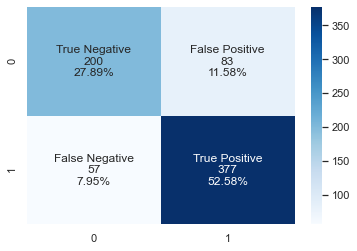

In [968]:

lr_predict = lr.predict(X_test2)
lr_conf_matrix = confusion_matrix(y_test, lr_predict)
lr_acc_score = accuracy_score(y_test, lr_predict)

group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                lr_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     lr_conf_matrix.flatten()/np.sum(lr_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(lr_conf_matrix, annot=labels, fmt="", cmap='Blues')

print("confussion matrix")
print(lr_conf_matrix)
print("\n")
print("Accuracy of Logistic Regression:",lr_acc_score*100,'\n')
print(classification_report(y_test,lr_predict))

# Desicion Tree

In [969]:
dect = tree.DecisionTreeClassifier(random_state=0)

In [970]:
modeldk = dect.fit(X_train, y_train)

In [971]:
print('Accuracy of Desicion Tree classifier on training set: {:.2f}'.format(dect.score(X_train2, y_train)))
print('Accuracy of Desicion Tree test set: {:.2f}'.format(dect.score(X_test2[X_train2.columns], y_test)))

Accuracy of Desicion Tree classifier on training set: 1.00
Accuracy of Desicion Tree test set: 0.74


# MAX Depth Identifier

In [972]:
max_depths = [2, 3, 4,5, 6,7, 8,9]
param_dictionary = {'max_depth': max_depths}

In [973]:
## Create a GridSearchCV object 
gridCVdt = sklearn.model_selection.GridSearchCV(dect, param_dictionary, return_train_score = True)
## Fit the GridSearchCV object to the data 
gridCVdt_result = gridCVdt.fit(X_train2, y_train)
#gridCVdt_result.cv_results_

In [974]:
## Create a dictioanry of the column names and arrays of values for each column 
results_dict = {'max_depth': gridCVdt_result.cv_results_['param_max_depth'], 'mean_fit_time': gridCVdt_result.cv_results_['mean_fit_time'], 'mean_test_score': gridCVdt_result.cv_results_['mean_test_score'], 'std_test_score': gridCVdt_result.cv_results_['std_test_score'], 'mean_train_score': gridCVdt_result.cv_results_['mean_train_score'], 'rank': gridCVdt_result.cv_results_['rank_test_score']}
## Convert the dictionary to a dataframe
results_df = pd.DataFrame(results_dict)
## Print the results (the additional formatting from above is automatically applied)
results_df

,max_depth,mean_fit_time,mean_test_score,std_test_score,mean_train_score,rank
0,2,0.008638,0.719494,0.029437,0.739085,8
1,3,0.011446,0.799653,0.016889,0.802782,1
2,4,0.011293,0.784102,0.017553,0.812202,2
3,5,0.010202,0.779319,0.020888,0.828050,3
4,6,0.012599,0.761375,0.021660,0.850030,4
5,7,0.012599,0.750024,0.028524,0.882178,5
6,8,0.013399,0.746433,0.017969,0.903561,6
7,9,0.018454,0.732058,0.012184,0.924943,7


In [975]:
print('best estimator: ', gridCVdt_result.best_estimator_)
print('parameter of best estimator: ', gridCVdt_result.best_params_)
print('score of the best estimator: ', gridCVdt_result.best_score_)

best estimator:  DecisionTreeClassifier(max_depth=3, random_state=0)
parameter of best estimator:  {'max_depth': 3}
score of the best estimator:  0.7996532308517293


In [976]:
# Here we got 0.7942 accuracy for Desicion Tree with Max depth of=3. 
#Lets apply Max depth=3 to below desicion tree algorithm 

# Evaluate Desicion Tree

confussion matrix
[[180 103]
 [ 44 390]]


Accuracy of DecisionTreeClassifier: 79.49790794979079 

              precision    recall  f1-score   support

           0       0.80      0.64      0.71       283
           1       0.79      0.90      0.84       434

    accuracy                           0.79       717
   macro avg       0.80      0.77      0.78       717
weighted avg       0.80      0.79      0.79       717



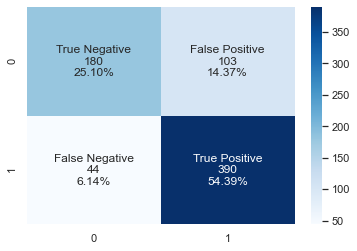

In [977]:
m6 = 'DecisionTreeClassifier'
dt = DecisionTreeClassifier(criterion = 'entropy',random_state=0,max_depth = 3)

dt.fit(X_train2, y_train)
dt_predicted = dt.predict(X_test2)

dt_conf_matrix = confusion_matrix(y_test, dt_predicted)
dt_acc_score = accuracy_score(y_test, dt_predicted)

group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                dt_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     dt_conf_matrix.flatten()/np.sum(dt_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(dt_conf_matrix, annot=labels, fmt="", cmap='Blues')


print("confussion matrix")
print(dt_conf_matrix)
print("\n")
print("Accuracy of DecisionTreeClassifier:",dt_acc_score*100,'\n')
print(classification_report(y_test,dt_predicted))

# Random Forest

In [1030]:
rf = RandomForestClassifier(random_state=0)
modelrf = rf.fit(X_train2, y_train)

In [1031]:
print('Accuracy of SVM classifier on training set: {:.2f}'.format(modelrf.score(X_train2, y_train)))
print('Accuracy of SVM classifier on test set: {:.2f}'.format(modelrf.score(X_test2[X_train2.columns], y_test)))

Accuracy of SVM classifier on training set: 1.00
Accuracy of SVM classifier on test set: 0.81


In [1032]:
# Identify the optimal number of Trees for Random Forest

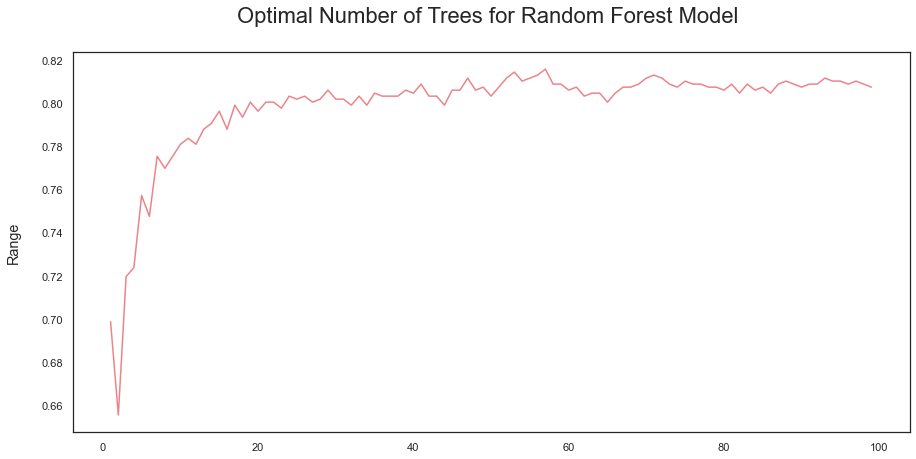

In [981]:
score_array = []
for each in range(1,100):
    rf_loop = RandomForestClassifier(
n_estimators = each, random_state = 1) 
    rf_loop.fit(X_train2,y_train)
    score_array.append(rf_loop.score(X_test2,y_test))
 
fig = plt.figure(figsize=(15, 7))
plt.plot(range(1,100),score_array, color = '#ec838a')
plt.ylabel('Range\n',horizontalalignment="center",
fontstyle = "normal", fontsize = "large", 
fontfamily = "sans-serif")

plt.title('Optimal Number of Trees for Random Forest Model \n',horizontalalignment="center", fontstyle = "normal", fontsize = "22", fontfamily = "sans-serif")
#plt.legend(loc='top right', fontsize = "medium")
plt.xticks(rotation=0, horizontalalignment="center")
plt.yticks(rotation=0, horizontalalignment="right")
plt.show()

# Evaluate Random Forest

confussion matrix
[[185  98]
 [ 41 393]]


Accuracy of Random Forest: 80.61366806136681 

              precision    recall  f1-score   support

           0       0.82      0.65      0.73       283
           1       0.80      0.91      0.85       434

    accuracy                           0.81       717
   macro avg       0.81      0.78      0.79       717
weighted avg       0.81      0.81      0.80       717



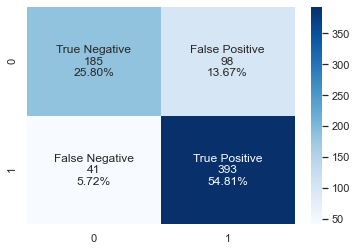

In [982]:
m3 = 'Random Forest Classfier'
rf = RandomForestClassifier(n_estimators=60, random_state=12,max_depth=7)
rf.fit(X_train2,y_train)
rf_predicted = rf.predict(X_test2)
rf_conf_matrix = confusion_matrix(y_test, rf_predicted)
rf_acc_score = accuracy_score(y_test, rf_predicted)

group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                rf_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     rf_conf_matrix.flatten()/np.sum(rf_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(rf_conf_matrix, annot=labels, fmt="", cmap='Blues')

print("confussion matrix")
print(rf_conf_matrix)
print("\n")
print("Accuracy of Random Forest:",rf_acc_score*100,'\n')
print(classification_report(y_test,rf_predicted))

# K Nearest Negbhor

In [983]:
kn = KNeighborsClassifier()

In [984]:
modelk = kn.fit(X_train2, y_train)
train_acc = modelk.score(X_train2, y_train)

In [985]:
print('Accuracy of SVM classifier on training set: {:.2f}'.format(modelk.score(X_train2, y_train)))
print('Accuracy of SVM classifier on test set: {:.2f}'.format(modelk.score(X_test2[X_train2.columns], y_test)))

Accuracy of SVM classifier on training set: 0.77
Accuracy of SVM classifier on test set: 0.70


In [986]:
error_rate=list()
#here we iterate meny different k values and plot their error rates 
#and discover which one is better than others and has the lowest error rate
for i in range(1,40):
    knn=KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train2,y_train)
    prediction_i=knn.predict(X_test2)
    error_rate.append(np.mean(prediction_i != y_test))

# Identify the optimal number of K neighbors for KNN Model

Text(0, 0.5, 'Error Rate')

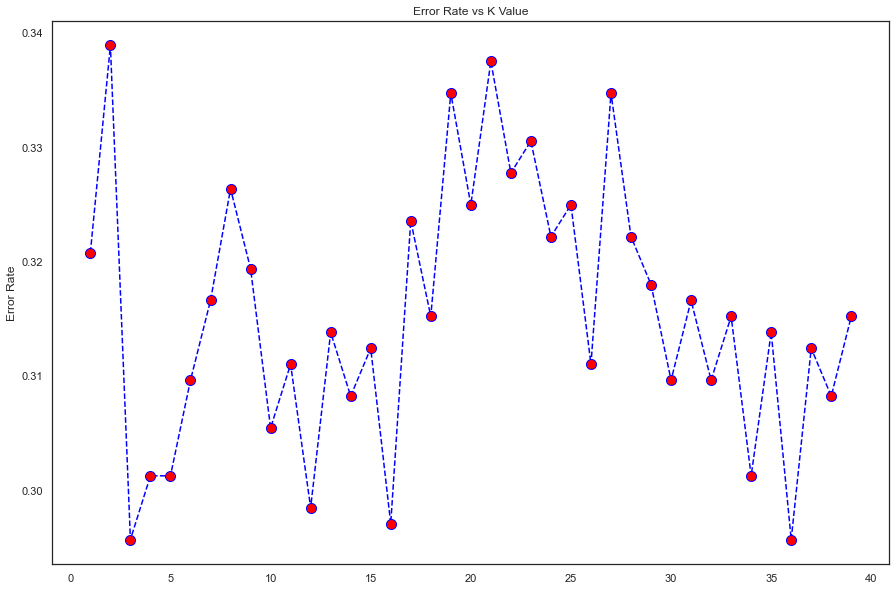

In [987]:
# Now we will plot the prediction error rates of different k values
plt.figure(figsize=(15,10))
plt.plot(range(1,40),error_rate, color="blue", linestyle="--",marker="o",markerfacecolor="red",markersize=10)
plt.title("Error Rate vs K Value")
plt.xlabel="K Value"
plt.ylabel("Error Rate")

# Evaluate KNN

confussion matrix
[[ 82 201]
 [ 23 411]]


Accuracy of K-NeighborsClassifier: 68.75871687587168 

              precision    recall  f1-score   support

           0       0.78      0.29      0.42       283
           1       0.67      0.95      0.79       434

    accuracy                           0.69       717
   macro avg       0.73      0.62      0.60       717
weighted avg       0.71      0.69      0.64       717



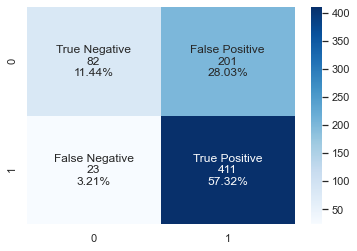

In [989]:
m5 = 'K-NeighborsClassifier'
knn = KNeighborsClassifier(n_neighbors=37)
knn.fit(X_train2, y_train)
knn_predicted = knn.predict(X_test2)
knn_conf_matrix = confusion_matrix(y_test, knn_predicted)
knn_acc_score = accuracy_score(y_test, knn_predicted)


group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                knn_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     knn_conf_matrix.flatten()/np.sum(knn_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(knn_conf_matrix, annot=labels, fmt="", cmap='Blues')


print("confussion matrix")
print(knn_conf_matrix)
print("\n")
print("Accuracy of K-NeighborsClassifier:",knn_acc_score*100,'\n')
print(classification_report(y_test,knn_predicted))

# SVM

In [990]:
svm = SVC()

In [991]:

modelsv = svm.fit(X_train2, y_train)
train_acc = modelsv.score(X_train2, y_train)


In [992]:
print('Accuracy of SVM classifier on training set: {:.2f}'.format(modelsv.score(X_train2, y_train)))
print('Accuracy of SVM classifier on test set: {:.2f}'.format(modelsv.score(X_test2[X_train2.columns], y_test)))

Accuracy of SVM classifier on training set: 0.86
Accuracy of SVM classifier on test set: 0.78


# Evaluate SVM

In [780]:
from sklearn.svm import SVC
from sklearn import svm 

In [781]:
gamma_vals = [0.001, 0.01, 0.1, 1, 'auto', 'scale']
c_vals = [0.01, 1, 10, 100, 1000]
param_dictionary = {'gamma': gamma_vals, 'C': c_vals}

In [782]:
from sklearn import svm 

svm_est = svm.SVC(decision_function_shape = 'ovr', kernel = 'rbf')

In [783]:
gridCV = sklearn.model_selection.GridSearchCV(svm_est, param_dictionary, return_train_score = True)
gridCV_result = gridCV.fit(X_train2, y_train)

In [784]:
## Create a dictioanry of the column names and arrays of values for each column 
results_dict = {'gamma': gridCV_result.cv_results_['param_gamma'], 'C': gridCV_result.cv_results_['param_C'], 'mean_fit_time': gridCV_result.cv_results_['mean_fit_time'], 'mean_test_score': gridCV_result.cv_results_['mean_test_score'], 'std_test_score': gridCV_result.cv_results_['std_test_score'], 'mean_train_score': gridCV_result.cv_results_['mean_train_score'], 'rank': gridCV_result.cv_results_['rank_test_score']}
## Convert the dictionary to a dataframe
results_df = pd.DataFrame(results_dict)
## The following two lines are a neat formatting trick that can be used in google colab (this is completely optional)
#from google.colab import data_table
#data_table.enable_dataframe_formatter()
## Print the results (the additional formatting from above is automatically applied)
results_df

,gamma,C,mean_fit_time,mean_test_score,std_test_score,mean_train_score,rank
0,0.001,0.01,0.105735,0.608253,0.000574,0.608254,25
1,0.01,0.01,0.105467,0.608253,0.000574,0.608254,25
2,0.1,0.01,0.124252,0.608253,0.000574,0.608254,25
3,1,0.01,0.125056,0.608253,0.000574,0.608254,25
4,auto,0.01,0.097385,0.608253,0.000574,0.608254,25
5,scale,0.01,0.096540,0.608253,0.000574,0.608254,25
6,0.001,1,0.086013,0.787103,0.018406,0.815643,1
7,0.01,1,0.089233,0.763180,0.016528,0.870964,6
8,0.1,1,0.117003,0.659110,0.017267,0.970694,17
9,1,1,0.140136,0.613038,0.003060,0.999103,24


In [133]:
## Your code here
print('best estimator: ', gridCV_result.best_estimator_)
print('parameter of best estimator: ', gridCV_result.best_params_)
print('score of the best estimator: ', gridCV_result.best_score_)

best estimator:  SVC(C=1, gamma=0.001)
parameter of best estimator:  {'C': 1, 'gamma': 0.001}
score of the best estimator:  0.7787255340066137


confussion matrix
[[183 100]
 [ 60 374]]


Accuracy of Support Vector Classifier: 77.68479776847977 

              precision    recall  f1-score   support

           0       0.75      0.65      0.70       283
           1       0.79      0.86      0.82       434

    accuracy                           0.78       717
   macro avg       0.77      0.75      0.76       717
weighted avg       0.77      0.78      0.77       717



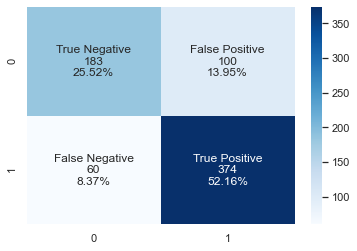

In [995]:
m7 = 'Support Vector Classifier'
svc =  SVC(kernel='rbf', C=1)
svc.fit(X_train2, y_train)
svc_predicted = svc.predict(X_test2)
svc_conf_matrix = confusion_matrix(y_test, svc_predicted)
svc_acc_score = accuracy_score(y_test, svc_predicted)

group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                svc_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     svc_conf_matrix.flatten()/np.sum(svc_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(svc_conf_matrix, annot=labels, fmt="", cmap='Blues')

print("confussion matrix")
print(svc_conf_matrix)
print("\n")
print("Accuracy of Support Vector Classifier:",svc_acc_score*100,'\n')
print(classification_report(y_test,svc_predicted))

# XGB

In [996]:
xgb_model =XGBClassifier(max_depth=5, learning_rate=0.08, objective= 'binary:logistic',n_jobs=-1).fit(X_train2, y_train)

C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:10:50] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [997]:
print('Accuracy of XGB classifier on training set: {:.2f}'.format(xgb_model.score(X_train2, y_train)))
print('Accuracy of XGB classifier on test set: {:.2f}'.format(xgb_model.score(X_test2[X_train2.columns], y_test)))

Accuracy of XGB classifier on training set: 0.92
Accuracy of XGB classifier on test set: 0.79


confussion matrix
[[191  92]
 [ 56 378]]


Accuracy of K-NeighborsClassifier: 79.3584379358438 

              precision    recall  f1-score   support

           0       0.77      0.67      0.72       283
           1       0.80      0.87      0.84       434

    accuracy                           0.79       717
   macro avg       0.79      0.77      0.78       717
weighted avg       0.79      0.79      0.79       717



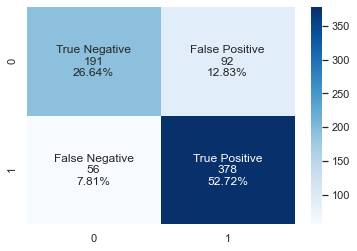

In [998]:
xgb_predicted = xgb_model.predict(X_test2)
xgb_conf_matrix = confusion_matrix(y_test, xgb_predicted)
xgb_acc_score = accuracy_score(y_test, xgb_predicted)

group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ['{0:0.0f}'.format(value) for value in
                xgb_conf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                     xgb_conf_matrix.flatten()/np.sum(xgb_conf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(xgb_conf_matrix, annot=labels, fmt="", cmap='Blues')

print("confussion matrix")
print(xgb_conf_matrix)
print("\n")
print("Accuracy of K-NeighborsClassifier:",xgb_acc_score*100,'\n')
print(classification_report(y_test,xgb_predicted))

# Comparing Algorithms and Choosing the most accurate one

In [999]:
model_ev = pd.DataFrame({'Model': ['Logistic Regression','Random Forest',
                    'K-Nearest Neighbour','Decision Tree','Support Vector Machine',' XGBoost'], 'Accuracy': [lr_acc_score*100,
                    rf_acc_score*100,knn_acc_score*100,dt_acc_score*100,gridCV_result.best_score_*100,xgb_acc_score*100]})
model_ev

,Model,Accuracy
0,Logistic Regression,80.474198
1,Random Forest,80.613668
2,K-Nearest Neighbour,68.758717
3,Decision Tree,79.497908
4,Support Vector Machine,78.710341
5,XGBoost,79.358438


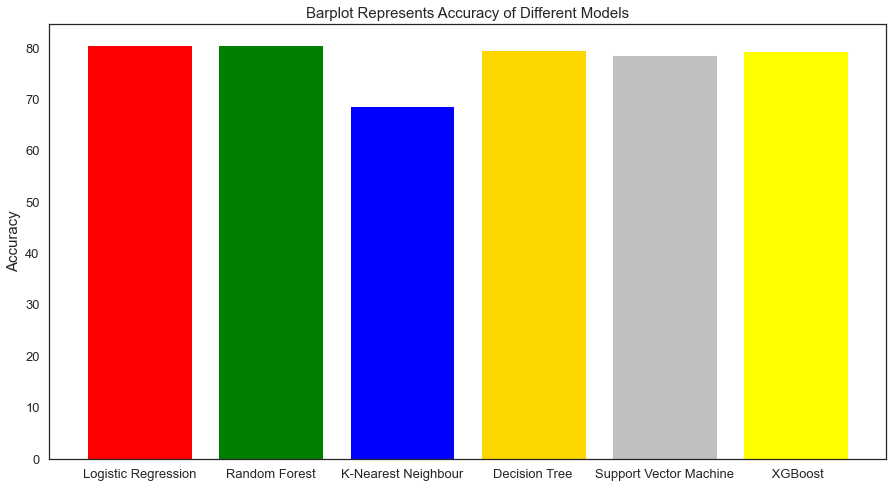

In [1000]:
colors = ['red','green','blue','gold','silver','yellow']
plt.figure(figsize=(15,8))

plt.title("Barplot Represents Accuracy of Different Models",fontsize=15)
plt.ylabel("Accuracy",fontsize=15)




plt.yticks(fontsize=13)
plt.xticks(fontsize=13)


plt.bar(model_ev['Model'],model_ev['Accuracy'],color = colors)
plt.show()

we can definitely conclude that logistic regression is an optimal model of choice for the given dataset as it has relatively the highest combination of precision, recall and F2 scores; giving most number of correct positive predictions while minimizing the false negatives. Hence, let's try to use Logistic Regression and evaluate its performance in the forthcoming sections

In [ ]:
xgb_model =XGBClassifier(max_depth=5, learning_rate=0.08, objective= 'binary:logistic',n_jobs=-1).fit(X_train2, y_train)

# K-Fold Cross-Validation

#Model evaluation is most commonly done through ‘K- fold Cross-Validation’ technique that primarily helps us to fix the variance.
#in order to fix the variance problem, k-fold cross-validation basically split the training set into 10 folds and train the model
#on 9 folds (9 subsets of the training dataset)
#before testing it on the test fold.

In [139]:
xgb_model =XGBClassifier(max_depth=5, learning_rate=0.08, objective= 'binary:logistic',n_jobs=-1).fit(X_train2, y_train)
# Predict the Test set results
y_predxgb = xgb_model.predict(X_test2)


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[19:33:13] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [1001]:
#Evaluate Model Results on Test Set:
acc = accuracy_score(y_test, y_predxgb )
prec = precision_score(y_test, y_predxgb )
rec = recall_score(y_test, y_predxgb )
f1 = f1_score(y_test, y_predxgb )
f2 = fbeta_score(y_test, y_predxgb, beta=2.0)
results = pd.DataFrame([['XGB',
acc, prec, rec, f1, f2]],columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'F2 Score'])
print (results)

  Model  Accuracy  Precision    Recall  F1 Score  F2 Score
0   XGB  0.793584   0.804255  0.870968  0.836283  0.856754


In [1002]:
accuracies = cross_val_score(estimator = xgb_model,X = X_train2, y = y_train, cv = 10)
print("XGB: %0.2f (+/- %0.2f)"  % (accuracies.mean(), accuracies.std() * 2))

C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:13] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:14] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:14] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:14] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:15] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:15] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:15] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:15] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:16] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:16] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
XGB: 0.79 (+/- 0.06)


# Evaluate the model using ROC Graph

It’s good to re-evaluate the model using ROC Graph. ROC Graph shows us the capability of a model to distinguish between the classes based on the AUC Mean score. The orange line represents the ROC curve of a random classifier while a good classifier tries to remain as far away from that line as possible. As shown in the graph below, the fine-tuned Logistic Regression model showcased a higher AUC score.

C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:25] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


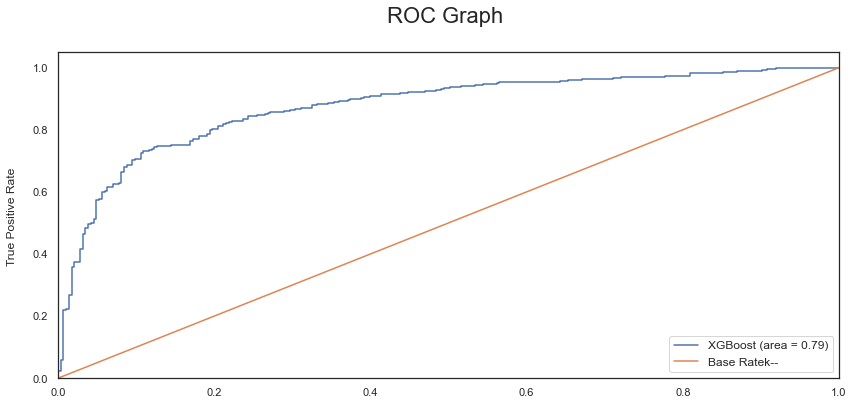

In [1003]:
xgb_model.fit(X_train2, y_train) 
probs = xgb_model.predict_proba(X_test2) 
probs = probs[:, 1] 
xgb_model_roc_auc = accuracy_score(y_test, y_predxgb )
rf_fpr, rf_tpr, rf_thresholds = roc_curve(y_test, xgb_model.predict_proba(X_test2)[:,1])
plt.figure(figsize=(14, 6))
# Plot Logistic Regression ROC
plt.plot(rf_fpr, rf_tpr, 
label='XGBoost (area = %0.2f)' % xgb_model_roc_auc)
# Plot Base Rate ROC
plt.plot([0,1], [0,1],label='Base Rate' 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.ylabel('True Positive Rate \n',horizontalalignment="center",
fontstyle = "normal", fontsize = "medium", 
fontfamily = "sans-serif")
#plt.xlabel('\nFalse Positive Rate \n',horizontalalignment="center",fontstyle = "normal", fontsize = "medium", fontfamily = "sans-serif")
plt.title('ROC Graph \n',horizontalalignment="center", 
fontstyle = "normal", fontsize = "22", 
fontfamily = "sans-serif")
plt.legend(loc="lower right", fontsize = "medium")
plt.xticks(rotation=0, horizontalalignment="center")
plt.yticks(rotation=0, horizontalalignment="right")
plt.show()

# Customer Prediction

# USING XGB

In [1004]:
xgb_model =XGBClassifier(max_depth=5, learning_rate=0.08, objective= 'binary:logistic',n_jobs=-1).fit(X_train2, y_train)
# Predict the Test set results
y_pred = xgb_model.predict(X_test2)
y_pred_probs = xgb_model.predict_proba(X_test2)
y_pred_probs  = y_pred_probs [:, 1]

C:\Users\amina\anaconda3\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:17:36] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [1005]:
df1 = pd.DataFrame(data=stc['ID'])
df2 = pd.DataFrame(data=stc['Retainedin2012'])
    
df3=pd.DataFrame(data=y_pred)
df4=pd.DataFrame(data=y_pred_probs)

In [1006]:
xgb_model =XGBClassifier(max_depth=5, learning_rate=0.08, objective= 'binary:logistic',n_jobs=-1).fit(X_train2, y_train)
# Predict the Test set results
y_pred = xgb_model.predict(data_fully_encoded)
y_pred_probs = xgb_model.predict_proba(X_test2)
y_pred_probs  = y_pred_probs [:, 1]

[09:17:42] WARNING: D:\bld\xgboost-split_1634712635879\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [1007]:
xgbclassifier=data_fully_encoded['XGB Probability to Come in 2013'] = xgb_model.predict_proba(data_fully_encoded[X_train2.columns])[:,1]
xgbclassifier
df3=pd.DataFrame(data=y_pred_probs)

In [1008]:
len(y_pred)

2389

In [554]:
#Pred2013=pd.DataFrame(y_pred)

In [1009]:
df1 = pd.DataFrame(data=data_fully_encoded['ID'])
df2 = pd.DataFrame(data=stc['Retainedin2012'])
final_predict = pd.concat([df1, df2], axis = 1).dropna()
final_predict["Probability to Come in 2013(%)"] = xgbclassifier*100
final_predict['Predictions'] = y_pred
final_predict

,ID,Retainedin2012,Probability to Come in 2013(%),Predictions
0,1,1,89.606018,1
1,2,1,76.006668,1
2,3,1,80.203644,1
3,4,0,24.716307,0
4,5,0,87.871742,1
5,6,1,78.837692,1
6,7,0,34.591888,0
7,8,0,84.000648,1
8,9,1,84.000648,1
9,10,1,83.011559,1


In [1010]:
final_predict.head()

,ID,Retainedin2012,Probability to Come in 2013(%),Predictions
0,1,1,89.606018,1
1,2,1,76.006668,1
2,3,1,80.203644,1
3,4,0,24.716307,0
4,5,0,87.871742,1


Text(0.5, 1.0, 'Customer Retention Prediction 2013 (XGB-2nd)')

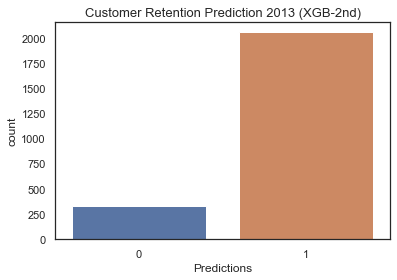

In [1011]:
sns.countplot(x='Predictions',data=final_predict)
plt.title('Customer Retention Prediction 2013 (XGB-2nd)', size = 13)


In [1012]:
print(pd.DataFrame(final_predict["Predictions"].value_counts()))

   Predictions
1         2056
0          333


In [512]:
#df1 = pd.DataFrame(data=data_fully_encoded['ID'])
#df2 = pd.DataFrame(data=stc['Retainedin2012'])
 
#df3=pd.DataFrame(data=y_pred)
#df4=pd.DataFrame(data=y_pred_probs)

In [510]:
#final_predict = pd.concat([df1, df2], axis = 1).dropna()

#final_predict["Probability to Come in 2013"] = df4
#final_predict["Probability to Come in 2013"] = df4*100
#final_predict["Probability to Come in 2013"]=final_results["Probability to Come in 2013"].round(2)
#final_predict['Predictions to Come in 2013'] = df3
#final_predict ['Ranking'] = pd.qcut(final_results['Probability to Come in 2013'].rank(method = 'first'),10,labels=range(10,0,-1))


#final_results.set_index(['ID'])

In [507]:
#prediction2013 = pd.concat([df1, df2], axis = 1).dropna()

#prediction2013["Probability to Come in 2013"] = df4
#prediction2013["Predictions to Come in 2013"] = df4*100
#prediction2013["Probability to Come in 2013"]=final_results["Predictions to Come in 2013"].round(2)
#prediction2013['Predictions to Come in 2013'] = df3
#prediction2013 ['Ranking'] = pd.qcut(prediction2013['Probability to Come in 2013'].rank(method = 'first'),10,labels=range(10,0,-1))


#prediction2013.set_index(['ID'])

# USING RANDOM FOREST

In [1033]:
rf = RandomForestClassifier(random_state=0)
modelrf = rf.fit(X_train2, y_train)

In [1034]:

y_pred = modelrf.predict(data_fully_encoded)
y_pred_probs = modelrf.predict_proba(X_test2)
y_pred_probs  = y_pred_probs [:, 1]

In [1035]:
df1 = pd.DataFrame(data=stc['ID'])
df2 = pd.DataFrame(data=stc['Retainedin2012'])
    
df3=pd.DataFrame(data=y_pred)
df4=pd.DataFrame(data=y_pred_probs)

In [1036]:
rfclassifier=data_fully_encoded['RF Probability to Come in 2013'] = modelrf.predict_proba(data_fully_encoded[X_train2.columns])[:,1]
rfclassifier
df3=pd.DataFrame(data=y_pred_probs)

In [1037]:
df1 = pd.DataFrame(data=data_fully_encoded['ID'])
df2 = pd.DataFrame(data=stc['Retainedin2012'])
final_predict = pd.concat([df1, df2], axis = 1).dropna()
final_predict["Probability to Come in 2013(%)"] = rfclassifier*100
final_predict['Predictions'] = y_pred
final_predict

,ID,Retainedin2012,Probability to Come in 2013(%),Predictions
0,1,1,69.0,1
1,2,1,65.0,1
2,3,1,66.0,1
3,4,0,43.0,0
4,5,0,67.0,1
5,6,1,58.0,1
6,7,0,46.0,0
7,8,0,66.0,1
8,9,1,68.0,1
9,10,1,66.0,1


Text(0.5, 1.0, 'Customer Retention Prediction 2013 (RandomForest)')

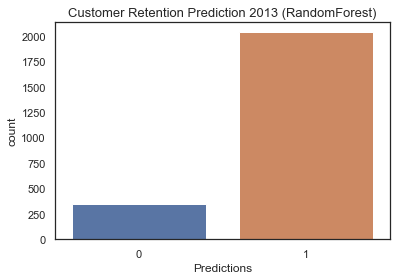

In [1039]:
sns.countplot(x='Predictions',data=final_predict)
plt.title('Customer Retention Prediction 2013 (RandomForest)', size = 13)

In [902]:
lr = LogisticRegression(random_state=0)
modelr = lr.fit(X_train2, y_train)

In [903]:
y_pred = modelr.predict(X_test2)
y_pred_probs = modelr.predict_proba(X_test2)
y_pred_probs  = y_pred_probs [:, 1]

In [907]:
df1 = pd.DataFrame(data=stc['ID'])
df2 = pd.DataFrame(data=stc['Retainedin2012'])
    
df3=pd.DataFrame(data=y_pred)
df4=pd.DataFrame(data=y_pred_probs)

In [908]:
Lrclassifier=data_fully_encoded['Lr Probability to Come in 2013'] = modelr.predict_proba(data_fully_encoded[X_train2.columns])[:,1]
Lrclassifier
df3=pd.DataFrame(data=y_pred_probs)

In [831]:

final_predict = pd.concat([df1, df2], axis = 1).dropna()
final_predict["Probability to Come in 2013(%)"] = rfclassifier*100
final_predict['Predictions'] = y_pred
final_predict.head()

,ID,Retainedin2012,Probability to Come in 2013(%)
2384,2385,0,94.557961
2385,2386,1,94.557961
2386,2387,1,92.904259
2387,2388,1,95.630119
2388,2389,1,94.164215
